# Rainfall Prediction - Weather Forecasting
### Problem Statement:

Weather forecasting is the application of science and technology to predict the conditions of the atmosphere for a given location and time. Weather forecasts are made by collecting quantitative data about the current state of the atmosphere at a given place and using meteorology to project how the atmosphere will change.

Rain Dataset is to predict whether or not it will rain tomorrow. The Dataset contains about 10 years of daily weather observations of different locations in Australia. Here, predict two things:

1) Design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.

2)  Design a predictive model with the use of machine learning algorithms to predict how much rainfall could be there.

In [1]:
# Importing the necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
%matplotlib inline
import warnings
warnings.simplefilter("ignore")
warnings.filterwarnings("ignore")

In [2]:
#Importing the dataset
df = pd.read_csv('weatherAUS.csv')
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


In [3]:
#Checking the shape of the dataset
df.shape

(8425, 23)

# Exploratory Data Analysis (EDA)

In [4]:
#Displaying the whole dataset
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [5]:
#Dislaying the columns
df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

### Dataset Description:

`Date`  - The date of observation

`Location`  -The common name of the location of the weather station

`MinTemp`  -The minimum temperature in degrees celsius

`MaxTemp` -The maximum temperature in degrees celsius

`Rainfall` -The amount of rainfall recorded for the day in mm

`Evaporation`  -The so-called Class A pan evaporation (mm) in the 24 hours to 9am

`Sunshine`  -The number of hours of bright sunshine in the day.

`WindGustDir`- The direction of the strongest wind gust in the 24 hours to midnight

`WindGustSpeed` -The speed (km/h) of the strongest wind gust in the 24 hours to midnight

`WindDir9am` -Direction of the wind at 9am

`WindDir3pm` -Direction of the wind at 3pm

`WindSpeed9am` -Wind speed (km/hr) averaged over 10 minutes prior to 9am

`WindSpeed3pm` -Wind speed (km/hr) averaged over 10 minutes prior to 3pm

`Humidity9am` -Humidity (percent) at 9am

`Humidity3pm` -Humidity (percent) at 3pm

`Pressure9am` -Atmospheric pressure (hpa) reduced to mean sea level at 9am

`Pressure3pm` -Atmospheric pressure (hpa) reduced to mean sea level at 3pm

`Cloud9am` - Fraction of sky obscured by cloud at 9am. 

`Cloud3pm` -Fraction of sky obscured by cloud 

`Temp9am` -Temperature (degrees C) at 9am

`Temp3pm` -Temperature (degrees C) at 3pm

`RainToday` -Boolean: 1 if precipitation (mm) in the 24 hours to 9am exceeds 1mm, otherwise 0

`RainTomorrow` -The amount of next day rain in mm. Used to create response variable . A kind of measure of the "risk".

## Initial observations -
We can see that our dataset comprises of 8425 rows and 23 columns. The output displays the top 5 and bottom 5 rows in the dataset. By observing which we can say that we have two target variables. The values present in our target column 'RainTomorrow' have data in categorical data type. So we can use Classification model in this case. While the other target variable 'Rainfall' is in continuous data making it a regression problem.

EDA and preprocessing is same for prediction of both the targets. so lets proceed with EDA.

# Exploratory Data Analysis (EDA)

In [6]:
#Getting an overall overview of the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8350 non-null   float64
 3   MaxTemp        8365 non-null   float64
 4   Rainfall       8185 non-null   float64
 5   Evaporation    4913 non-null   float64
 6   Sunshine       4431 non-null   float64
 7   WindGustDir    7434 non-null   object 
 8   WindGustSpeed  7434 non-null   float64
 9   WindDir9am     7596 non-null   object 
 10  WindDir3pm     8117 non-null   object 
 11  WindSpeed9am   8349 non-null   float64
 12  WindSpeed3pm   8318 non-null   float64
 13  Humidity9am    8366 non-null   float64
 14  Humidity3pm    8323 non-null   float64
 15  Pressure9am    7116 non-null   float64
 16  Pressure3pm    7113 non-null   float64
 17  Cloud9am       6004 non-null   float64
 18  Cloud3pm

In [7]:
#Checking the data types of the dataset
df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

We can see that we have both object and float data types. While most of the data is in float data type only few columns are in object type data.

In [8]:
#checking the unique numbers of the dataset
df.nunique()

Date             3004
Location           12
MinTemp           285
MaxTemp           331
Rainfall          250
Evaporation       116
Sunshine          140
WindGustDir        16
WindGustSpeed      52
WindDir9am         16
WindDir3pm         16
WindSpeed9am       34
WindSpeed3pm       35
Humidity9am        90
Humidity3pm        94
Pressure9am       384
Pressure3pm       374
Cloud9am            9
Cloud3pm            9
Temp9am           304
Temp3pm           328
RainToday           2
RainTomorrow        2
dtype: int64

In [9]:
#Checkig for null values in the dataset
df.isnull().sum()

Date                0
Location            0
MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustDir       991
WindGustSpeed     991
WindDir9am        829
WindDir3pm        308
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm         2455
Temp9am            56
Temp3pm            96
RainToday         240
RainTomorrow      239
dtype: int64

<AxesSubplot:>

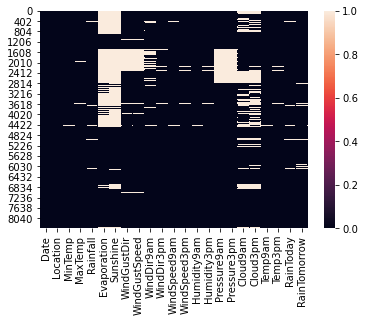

In [10]:
#Visualizing the null values using a heatmap
sns.heatmap(df.isnull())

## Observations
- In the above output we can see that there are missing values in many columns and few even have approximately 50% of the data empty. Such columns need to be removed since it provides no insights.

- Though we have the following columns with nearly 50% of missing values... they are important features. Hence we cannot drop them
    - Sunshine has 3994 null values which says 47.4% of the data is missing
    - Evaporation has 3512 null values which says 41.6% of the data is missing

- There are null values in the target columns too.
- All the null values need to be treated using respective imputation methods

## FEATURE ENGINEERING

### Filling null values 

Filling the null values for those columns having numerical(float) type data using mean and filling the null values for those columns having categorical(object) type data using mode

In [11]:
#Filling null values in MinTemp with it's mean
df['MinTemp'] = df['MinTemp'].fillna(df['MinTemp'].mean())

#Filling null values in MaxTemp with it's mean
df['MaxTemp'] = df['MaxTemp'].fillna(df['MaxTemp'].mean())

#Fillinf null values in Rainfall with it's mode, as most of the rows have 0 rainfall.
df['Rainfall'] = df['Rainfall'].fillna(df['Rainfall'].mode()[0])

#Filling null values in Evaporation with it's mean
df['Evaporation'] = df['Evaporation'].fillna(df['Evaporation'].mean())

#Filling null values in Sunshine with it's mean
df['Sunshine'] = df['Sunshine'].fillna(df['Sunshine'].mean())

#Filling null values in WindGustDir with it's mode
df['WindGustDir'] = df['WindGustDir'].fillna(df['WindGustDir'].mode()[0])

#Filling null values in WindGustSpeed with it's mean
df['WindGustSpeed'] = df['WindGustSpeed'].fillna(df['WindGustSpeed'].mean())

#Filling null values in WindDir9am with it's mode
df['WindDir9am'] = df['WindDir9am'].fillna(df['WindDir9am'].mode()[0])

#Filling null values in WindDir3pm with it's mode
df['WindDir3pm'] = df['WindDir3pm'].fillna(df['WindDir3pm'].mode()[0])

#Filling null values in WindSpeed9am with it's mean
df['WindSpeed9am'] = df['WindSpeed9am'].fillna(df['WindSpeed9am'].mean())

#Filling null values in WindSpeed3pm with it's mean
df['WindSpeed3pm'] = df['WindSpeed3pm'].fillna(df['WindSpeed3pm'].mean())

#Filling null values in Humidity9am with it's mean
df['Humidity9am'] = df['Humidity9am'].fillna(df['Humidity9am'].mean())

#Filling null values in Humidity3pm with it's mean
df['Humidity3pm'] = df['Humidity3pm'].fillna(df['Humidity3pm'].mean())

#Filling null values in Pressure9am with it's mean
df['Pressure9am'] = df['Pressure9am'].fillna(df['Pressure9am'].mean())

#Filling null values in Pressure3pm with it's mean
df['Pressure3pm'] = df['Pressure3pm'].fillna(df['Pressure3pm'].mean())

#Filling null values in Cloud9am with it's mean
df['Cloud9am'] = df['Cloud9am'].fillna(df['Cloud9am'].mean())

#Filling null values in Cloud3pm with it's mean
df['Cloud3pm'] = df['Cloud3pm'].fillna(df['Cloud3pm'].mean())

#Filling null values in Temp9am with it's mean
df['Temp9am'] = df['Temp9am'].fillna(df['Temp9am'].mean())

#Filling null values in Temp3pm with it's mean
df['Temp3pm'] = df['Temp3pm'].fillna(df['Temp3pm'].mean())

#Filling null values in Temp3pm with it's mean
df['Temp3pm'] = df['Temp3pm'].fillna(df['Temp3pm'].mean())

#Filling null values in RainToday with it's mode
df['RainToday'] = df['RainToday'].fillna(df['RainToday'].mode()[0])

#Filling null values in RainTomorrow with it's mode
df['RainTomorrow'] = df['RainTomorrow'].fillna(df['RainTomorrow'].mode()[0])

In [12]:
#Converting date column to datetime format
df['Date'] = pd.to_datetime(df['Date'])

In [13]:
#Extracting Day from Date_of_journey column
df['Day'] = pd.to_datetime(df.Date,format="%d/%m/%Y").dt.day

#Extracting Month from Date_of_journey column
df['Month'] = pd.to_datetime(df.Date, format="%d/%m/%Y").dt.month

#Extracting Year from Date_of_journey column
df['Year'] = pd.to_datetime(df.Date, format="%d/%m/%Y").dt.year

In [14]:
#Dropping the Date column as it is redundant
df.drop(columns=['Date'],axis=1,inplace=True)

In [15]:
#Viewing the top 5 rows in the dataset
df.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,Albury,13.4,22.9,0.6,5.389395,7.632205,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,No,No,1,12,2008
1,Albury,7.4,25.1,0.0,5.389395,7.632205,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,No,No,2,12,2008
2,Albury,12.9,25.7,0.0,5.389395,7.632205,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,No,No,3,12,2008
3,Albury,9.2,28.0,0.0,5.389395,7.632205,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,No,No,4,12,2008
4,Albury,17.5,32.3,1.0,5.389395,7.632205,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,No,No,5,12,2008


In [16]:
# Checking fo null values again
df.isnull().sum()

Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
Day              0
Month            0
Year             0
dtype: int64

<AxesSubplot:>

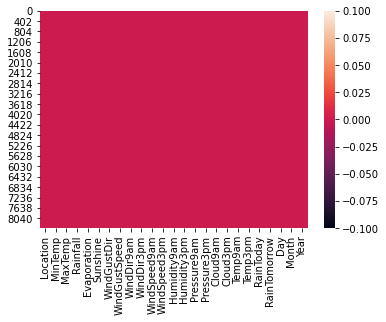

In [17]:
#Visualizing the null values using a heatmap
sns.heatmap(df.isnull())

This shows all the null values have been treated

# Statistical summary of the Dataset

In [18]:
# Viewing the statistical summary using describe method
df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Day,Month,Year
count,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000
mean,13.193305,23.859976,2.725982,5.389395,7.632205,40.174469,13.847646,18.533662,67.822496,51.249790,1017.640233,1015.236075,4.566622,4.503183,17.762015,22.442934,15.741958,6.442136,2012.102433
std,5.379488,6.114516,10.319872,3.852004,2.825451,13.776101,10.128579,9.704759,16.774231,18.311894,6.275759,6.217451,2.429205,2.299419,5.608301,5.945849,8.787354,3.437994,2.473137
min,-2.000000,8.200000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,10.000000,6.000000,989.800000,982.900000,0.000000,0.000000,1.900000,7.300000,1.000000,1.000000,2008.000000
25%,9.300000,19.300000,0.000000,4.000000,7.632205,31.000000,6.000000,11.000000,56.000000,39.000000,1014.000000,1011.400000,3.000000,3.000000,13.800000,18.100000,8.000000,3.000000,2010.000000
50%,13.200000,23.300000,0.000000,5.389395,7.632205,40.174469,13.000000,19.000000,68.000000,51.000000,1017.640233,1015.236075,4.566622,4.503183,17.762015,22.000000,16.000000,6.000000,2011.000000
75%,17.300000,28.000000,0.800000,5.389395,8.900000,48.000000,20.000000,24.000000,80.000000,63.000000,1021.300000,1018.800000,7.000000,7.000000,21.900000,26.300000,23.000000,9.000000,2014.000000
max,28.500000,45.500000,371.000000,145.000000,13.900000,107.000000,63.000000,83.000000,100.000000,99.000000,1039.000000,1036.000000,8.000000,8.000000,39.400000,44.100000,31.000000,12.000000,2017.000000


# Observations
The describe method shows statistical summary of the numerical columns only, it doesnot displays the categorical data. From the above table we can say that

- The count of all the columns is uniform which says there are no null values in the dataset.

- The Rainfall columns has mean value higher than the median (50% - 2nd quantile), so the distribution is skewed to right
    
- Other columns have mean almost equal to median, which says the distribution of curve is normal

- The following columns have huge difference between the 75% (3rd quantile) and the max values, which shows the chance for presence of outliers
    - MinTemp	
    - MaxTemp	
    - Rainfall	
    - Evaporation	
    - Sunshine	
    - WindGustSpeed	
    - WindSpeed9am	
    - WindSpeed3pm	
    - Humidity9am	
    - Humidity3pm
    - Temp9am	
    - Temp3pm

- The following columns have no much difference between the 75% (3rd quantile) and the max values, which shows there are less  chance for presence of outliers
    - Pressure9am	
    - Pressure3pm	
    - Cloud9am	
    - Cloud3pm

In [19]:
for col in df:
    print(col)
    print(df[col].value_counts())
    print("-"*100)

Location
Melbourne       1622
Williamtown     1230
PerthAirport    1204
Albury           907
Newcastle        822
CoffsHarbour     611
Brisbane         579
Penrith          482
Wollongong       474
Darwin           250
Adelaide         205
Uluru             39
Name: Location, dtype: int64
----------------------------------------------------------------------------------------------------
MinTemp
 13.193305    75
 12.000000    74
 13.200000    71
 13.800000    69
 12.700000    68
 16.400000    67
 14.800000    67
 10.800000    66
 17.800000    65
 13.300000    64
 13.700000    64
 10.000000    63
 14.200000    61
 16.100000    61
 13.000000    60
 18.400000    60
 10.500000    59
 18.700000    59
 11.400000    59
 15.600000    59
 13.600000    58
 14.500000    58
 11.800000    58
 10.700000    57
 18.500000    57
 12.100000    57
 10.100000    57
 9.500000     57
 16.300000    57
 14.000000    56
 8.400000     56
 17.500000    56
 9.000000     56
 8.000000     56
 12.800000    54
 9.400

# Visualization

## Checking the categorical columns and numerical columns

In [20]:
#checking categorical columns
cat_col=[]
for i in df.dtypes.index:
    if df.dtypes[i]=='object':
        cat_col.append(i)
print(cat_col)

['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']


In [21]:
# checking for numerical columns
num_col=[]
for i in df.dtypes.index:
    if df.dtypes[i]!='object':
        num_col.append(i)
print(num_col)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Day', 'Month', 'Year']


# Univariate Analysis

### Plotting count plots of the categorical columns

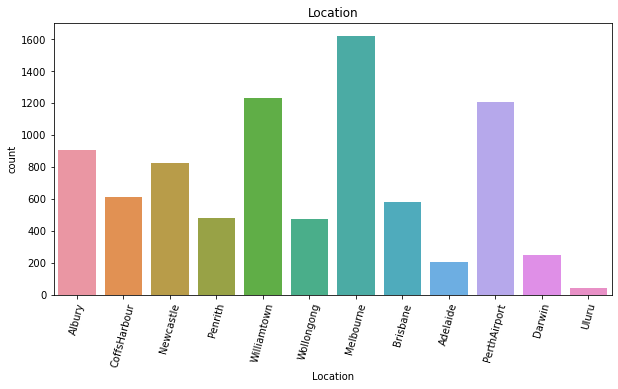

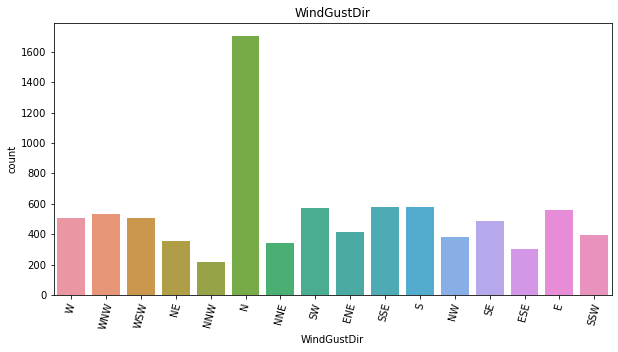

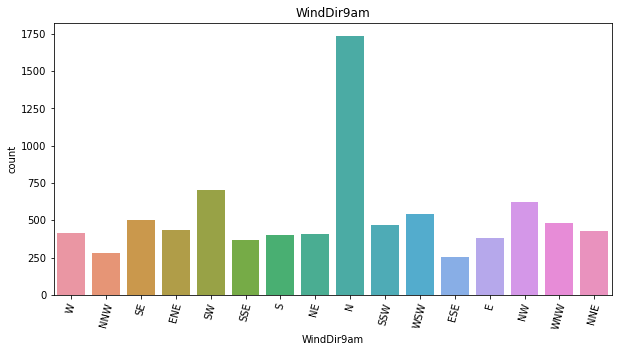

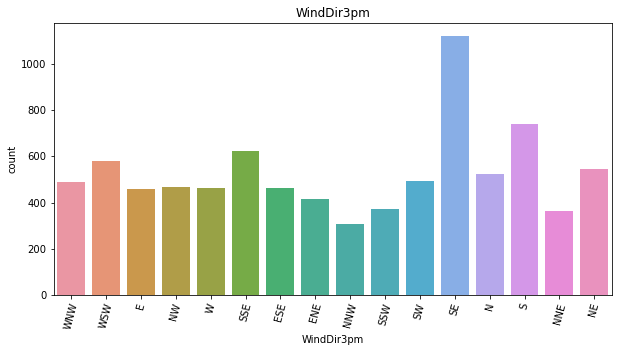

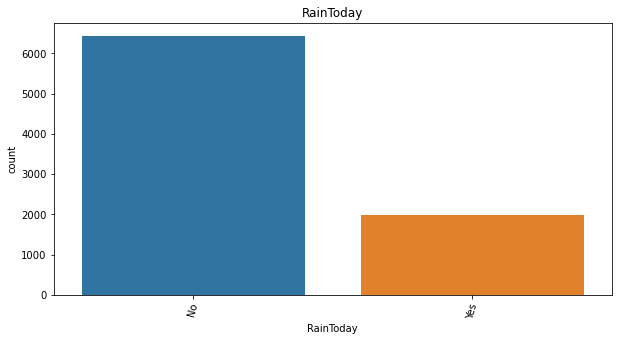

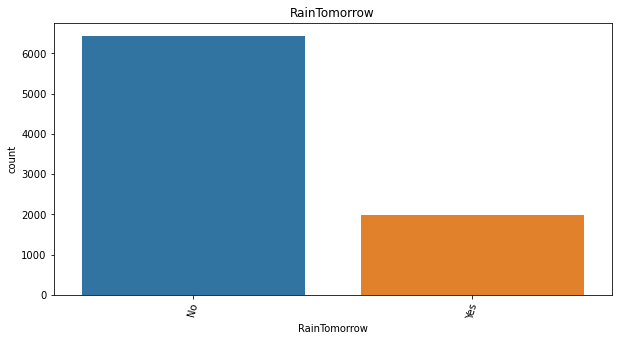

In [22]:
# Visualizing the various cat_col present in the dataset
for i in cat_col:
    plt.figure(figsize=(10,5))
    sns.countplot(df[i])
    plt.title(i)
    plt.xticks(rotation=75)
    plt.show()

# Observations
- Melbourne has highest count in the Location column, where as Uluru has the least count
- N has the highest count in the WindGustDir, where as the NNW has the least count
- N has the highest count in the WindDir9am, where as NNW has the least count
- SE has the highest count in the WindDir3pm, where as the NNW has the least count
- No RainToday has high count
- No RainTomorrow has high count

## Visualizing the distribution of the numerical columns

In [23]:
# Viewing the number of columns in the num_col list
len(num_col)

19

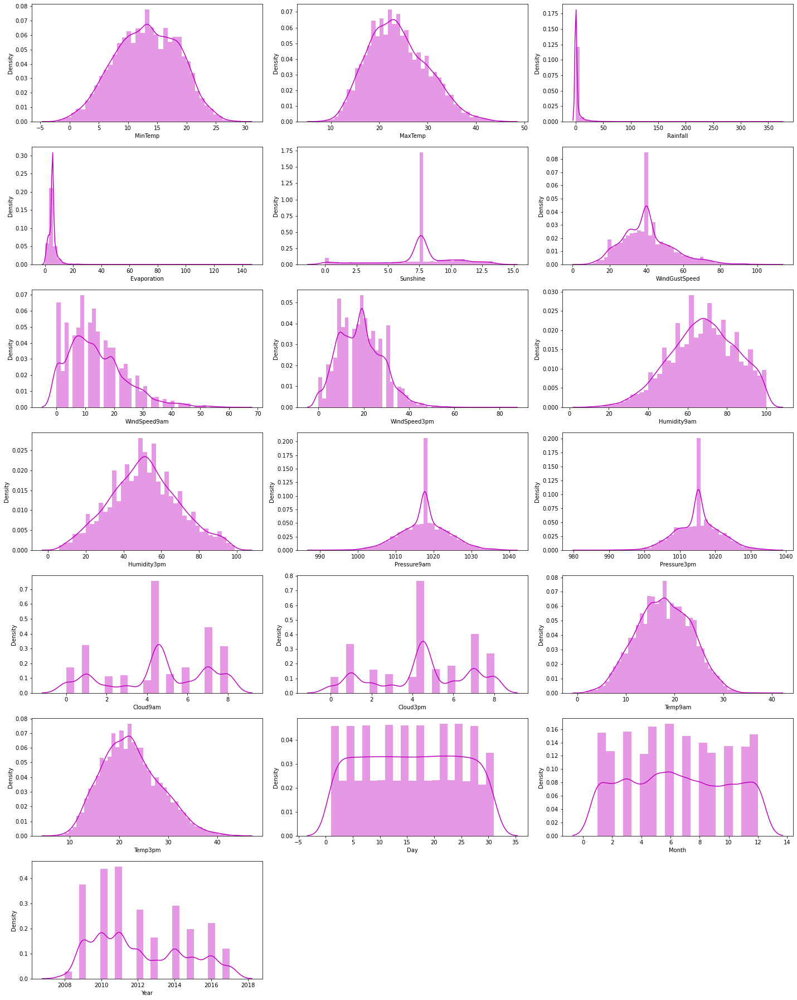

In [24]:
plt.figure(figsize=(20,25),facecolor='white')
plotnumber=1
for column in num_col:
    if plotnumber<=20:
        ax=plt.subplot(7,3,plotnumber)
        sns.distplot(df[column],color="m")
        plt.xlabel(column,fontsize=10)
        plt.yticks(rotation=0,fontsize=10)
    plotnumber+=1
plt.tight_layout()

# Observations
- We can see most of the features have normal distribution 
- Some of the features are skewed to the right  and left as expected , this confirms the presence of the skewness

# Bivariate Analysis

Checking the relation between the features and the two targert variables

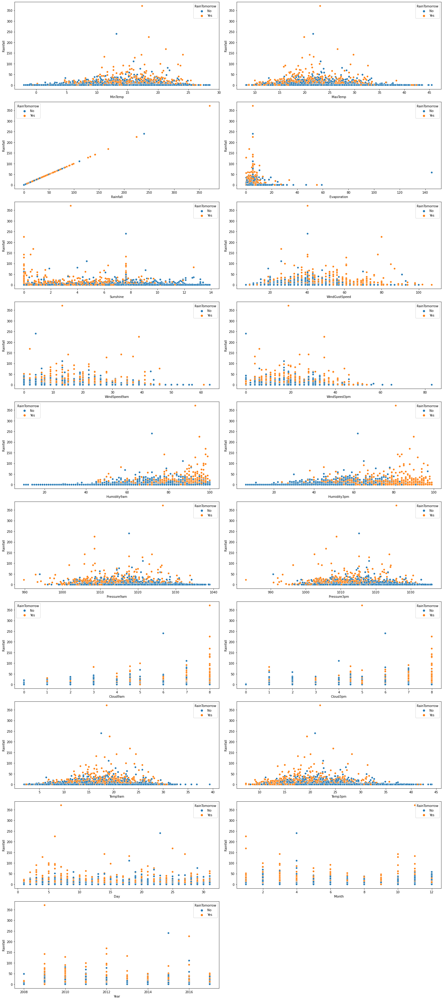

In [25]:
plt.figure(figsize=(20,45),facecolor='white')
plotnumber=1
for column in num_col:
    if plotnumber<=20:
        ax=plt.subplot(10,2,plotnumber)
        sns.scatterplot(x=column,y='Rainfall' ,data=df, hue = 'RainTomorrow')
        plt.xlabel(column,fontsize=10)
        plt.yticks(rotation=0,fontsize=10)
    plotnumber+=1
plt.tight_layout()

# Observations
From the above plots we can say that

- As the MinTemp is between 10 and 20 it shows there is lower level of rainfall with high chance of no rainfall tomorrow
- As the MaxTemp is between 10 and 35 there is a lower level of rainfall with high chance of rainfall tomorrow
- Most of the rainfall is lower level and is densely populated at the lower level of evaporation. The more the evaporation, more the chance of rain tomorrow
- As the sunshine is lower there is more chance of rainfall and rain tomorrow
- When the wind speed is between 20 and 60 there is a chance of lower level rainfall with equal chance of rain tomorrow
- When the windspeed9am is between 5 and 30 there is a rainfall of lower level with high chance of rain tomorrow
- When the windspeed3pm is between 5 and 45 there is a rainfall of higher level with high chance of rain tomorrow
- When humidity9am is between 45 and 100 there is rainfall with higher chance of rain tomorrow increases as the humidity increases
- When humidity3pm is between 30 and 100 there is rainfall with higher chance of rain tomorrow increases as the humidity increases
- When the Pressure9am is between 1000 and 1030 there is rainfall with higher chance of no rain tomorrow as the pressure increases
- When the Pressure3pm is between 1000 and 1020 there is rainfall with higher chance of no rain tomorrow as the pressure increases
- If Cloud9am is higher there is higher rain fall and higher chance of rain tomorrow
- If Cloud3pm is higher there is higher rain fall and higher chance of rain tomorrow
- When Temp9am is between 10 and 30 there is a rainfall and higher chance of no rain tomorrow
- When Temp3pm is between 10 and 30 there is a rainfall and higher chance of no rain tomorrow
- There is more rainfall in the first 10 days of the month and there is high chance of rain tomorrow compared to other days
- There is high rain fall in the months of 2,3,4, and 10, 11 with high chance of rain tomorrow compared to other months
- The year 2012 has higher rainfall with higher chances of rain tomorrow than other years


In [26]:
# Viewing the number of columns in the cat_col list
len(cat_col)

6

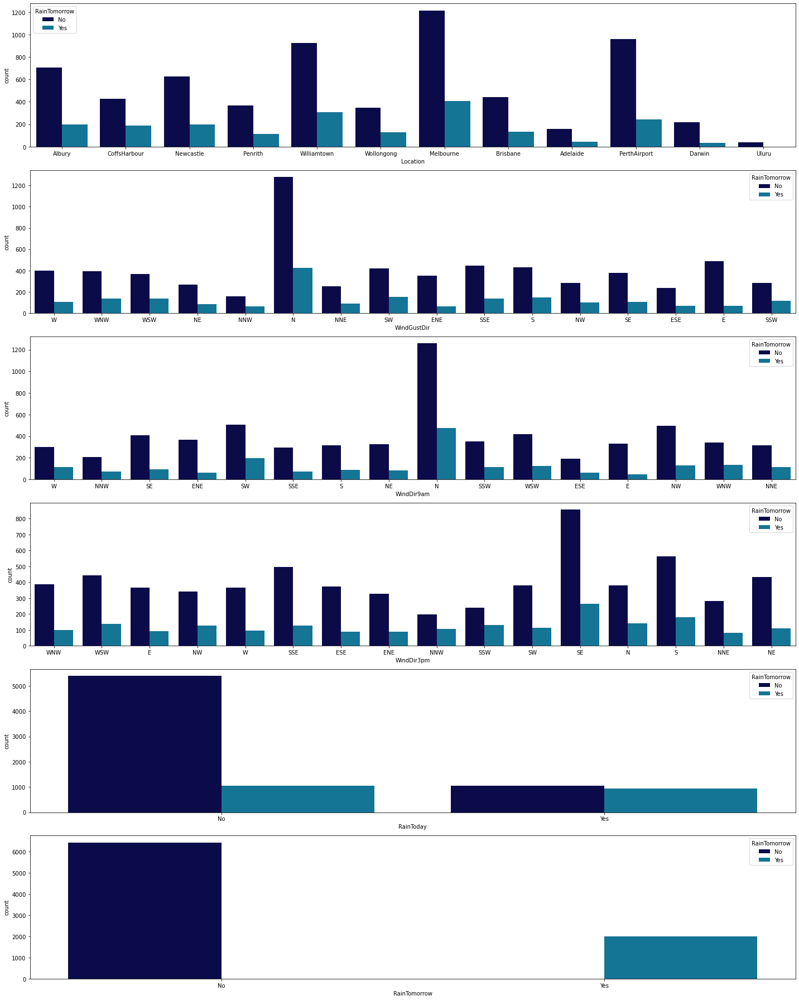

In [27]:
plt.figure(figsize=(20,25),facecolor='white')
plotnumber=1
for column in cat_col:
    if plotnumber<=6:
        ax=plt.subplot(6,1,plotnumber)
        sns.countplot(x=column,data=df, hue='RainTomorrow',palette= 'ocean')
        plt.xlabel(column,fontsize=10)
        plt.yticks(rotation=0,fontsize=10)
    plotnumber+=1
plt.tight_layout()

# Observations
From the above plots we can say that

- Melbourne has high rainfall with lower chance of rain tomorrow
- Uluru has lower rainfall and there is no chance for rain tomorrow
- N has high rainfall in WindGustDir with higher chance of no rain tomorrow
- In WindGustDir NNW has lower rainfall with lowest chance of rain tomorrow
- N has high rain fall in WindDir9am with higher chance of no rain tomorrow
- SE has high rain fall in WindDir3pm with higher chance of no rain tomorrow
- There is high chance for no rain today with no rain today and no rain tomorrow

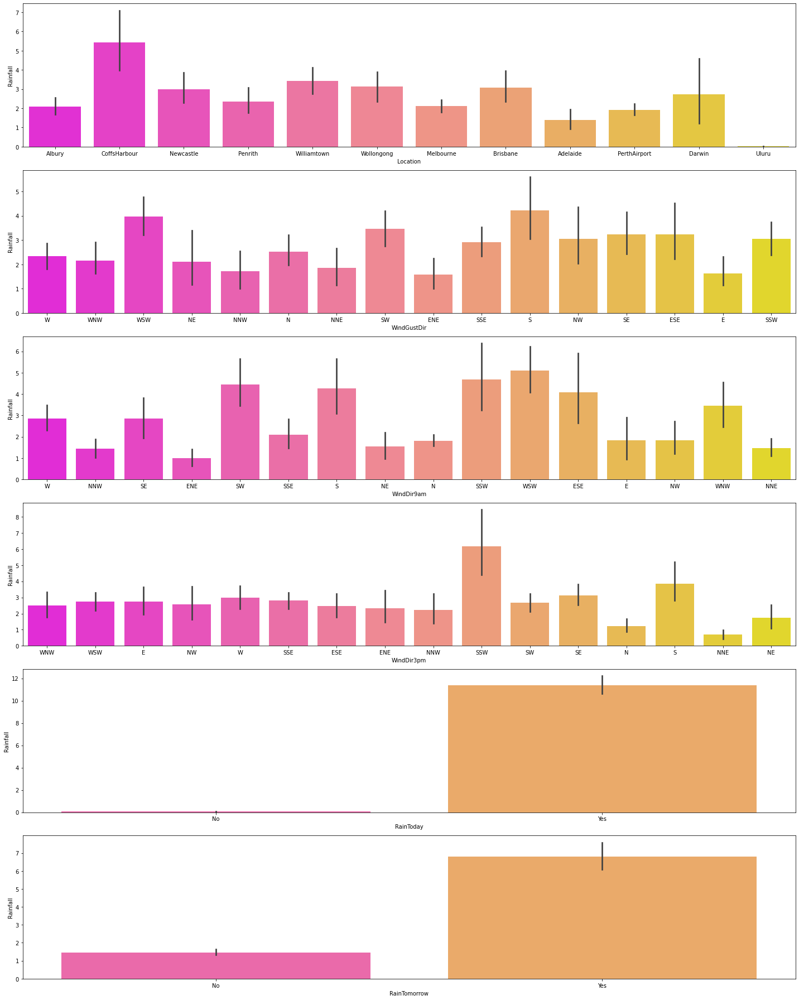

In [28]:
plt.figure(figsize=(20,25),facecolor='white')
plotnumber=1
for column in cat_col:
    if plotnumber<=6:
        ax=plt.subplot(6,1,plotnumber)
        sns.barplot(x=column,y='Rainfall',data=df,palette= 'spring' )
        plt.xlabel(column,fontsize=10)
        plt.xticks(rotation=0,fontsize=10)
    plotnumber+=1
plt.tight_layout()

# Observations
From the above plots we can say that

- CoffsHarbour has higher rainfall and uluru has lowest rainfall compared to others 
- S has higher rainfall and E has lowestrainfall in WindGustDir
- Rain fall is highest in the WSW of WindDir9am and ENE has lowest rainfall
- Rain fall is highest in the SSW of WindDir3pm and NNE has lowest rainfall
- RainToday has higher chance of rainfall
- Rain tomorrow has higher chance of rainfall

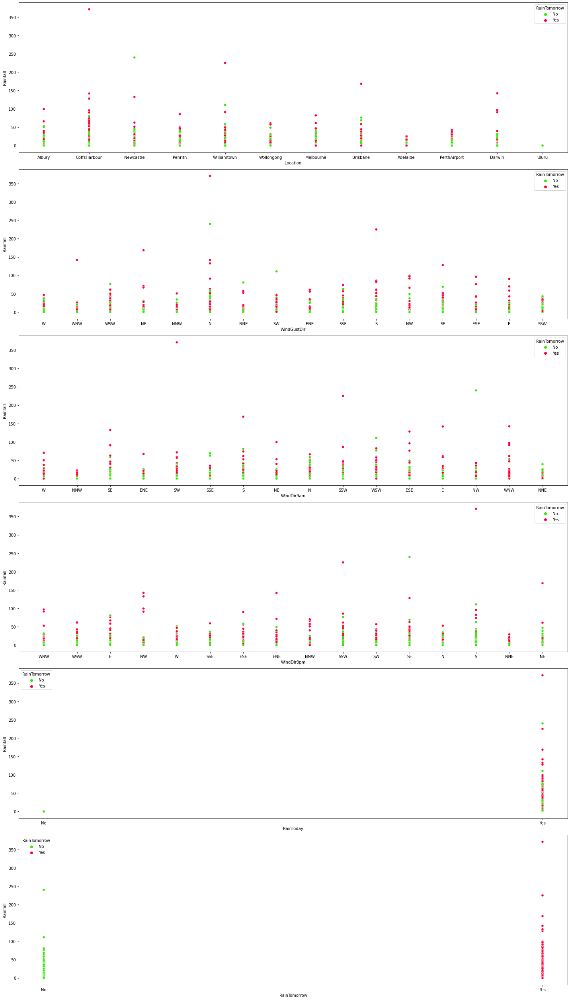

In [29]:
plt.figure(figsize=(20,35),facecolor='white')
plotnumber=1
for column in cat_col:
    if plotnumber<=6:
        ax=plt.subplot(6,1,plotnumber)
        sns.scatterplot(x=column, y= "Rainfall", hue='RainTomorrow', data=df,palette='prism')
        plt.xlabel(column,fontsize=10)
        plt.yticks(rotation=0,fontsize=10)
    plotnumber+=1
plt.tight_layout()

# Observations

From the above plots we can say that

- CoffsHarbour has higher rainfall with higher chance of rain tomorrow and uluru has lowest rainfall with high chance of rain tomorrow compared to others 
- N has higher rainfall with higher chance of higher chance of rain tomorrow and E has lowestrainfall in WindGustDir
- Rain fall is highest in the WSW in WindDir9am with higher chance of rain tomorrow and ENE has lowest rainfall
- Rain fall is highest in the SSW in WindDir3pm with higher chance of rain tomorrow and NNE has lowest rainfall with high chance of rain tomorrow
- RainToday has higher chance of rainfall
- Rain tomorrow has higher chance of rainfall

# Multivariate Analysis

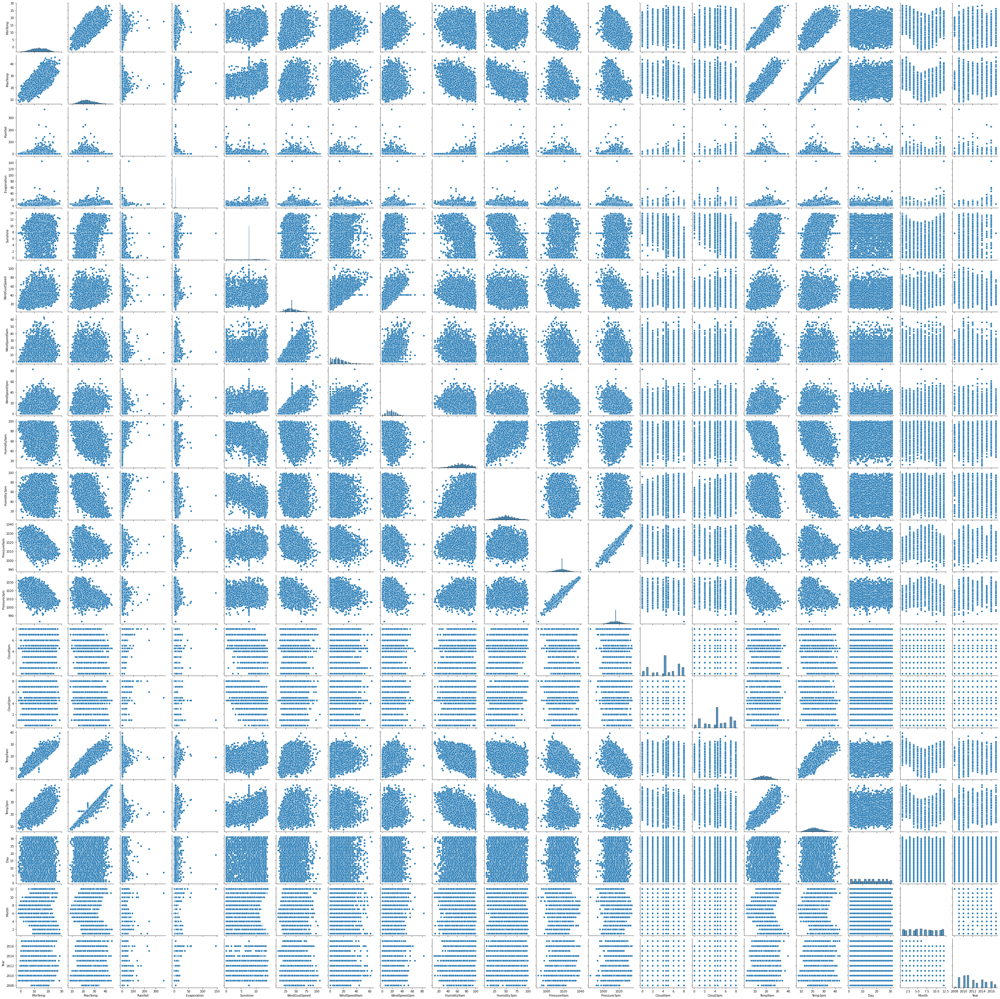

In [30]:
#Using pair plot for multivariate analysis
sns.pairplot(df)

# Observations
- Most of the pair plots are linear and outliers are observed in some of the features.

# Data Cleaning

### Outliers

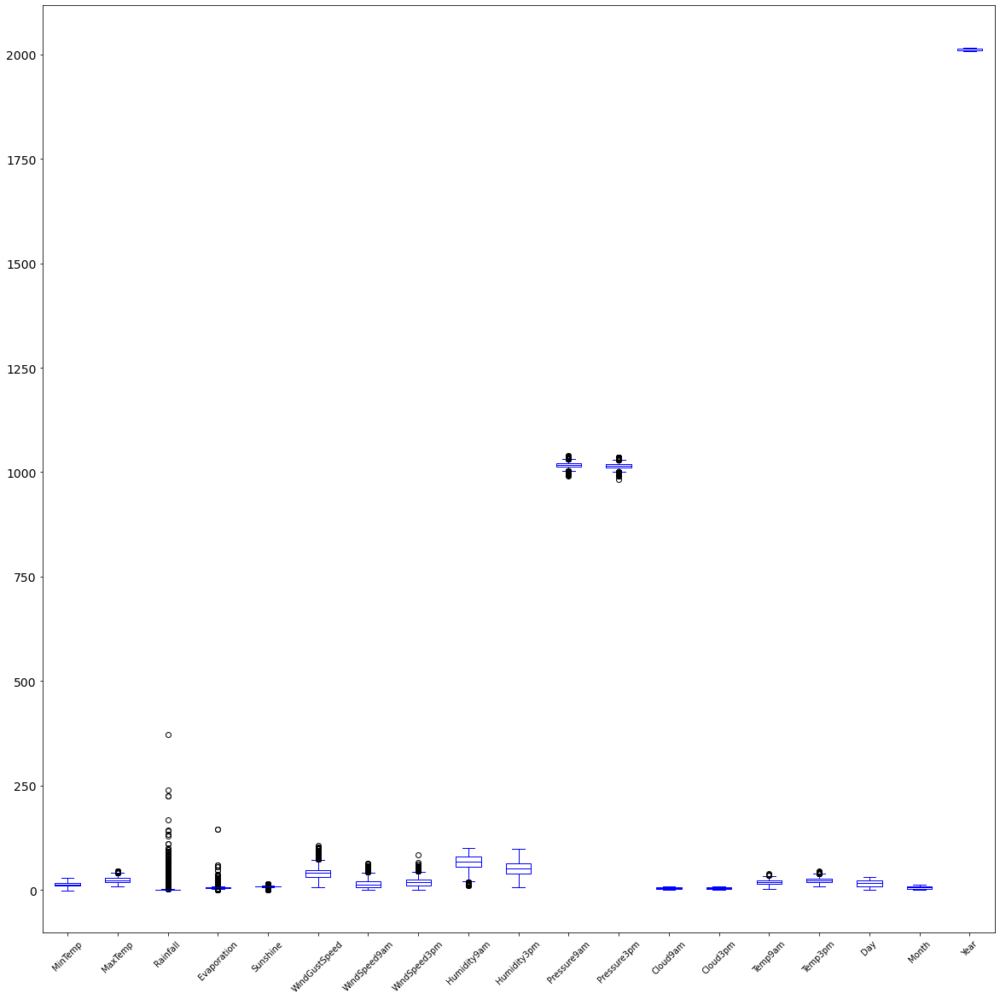

In [31]:
#Checking for outliers
df.plot(kind='box',fontsize=14,figsize=(20,20),color='b')
plt.xticks(rotation=45,fontsize=10)
plt.show()

# Observations
Outliers are present in all the columns except the following columns of the dataset
- MinTemp, 
- Humidity3pm, 
- Cloud9am, 
- Cloud3pm, 
- Day, 
- Month, 
- Year


### Removing Outliers:

#### I) Zscore method

In [32]:
#Features that are having outliers
features=df[['MaxTemp', 'Rainfall','Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am','WindSpeed3pm','Humidity9am','Pressure9am', 'Pressure3pm','Temp9am','Temp3pm']]

In [33]:
from scipy.stats import zscore
z=np.abs(zscore(features))
df_new=df[(z<3).all(axis=1)]
z

array([[1.57008852e-01, 2.06020811e-01, 2.30589346e-16, ...,
        1.30866453e+00, 1.53712470e-01, 1.08138052e-01],
       [2.02812062e-01, 2.64164519e-01, 2.30589346e-16, ...,
        1.19607152e+00, 1.00217155e-01, 3.12348332e-01],
       [3.00945038e-01, 2.64164519e-01, 2.30589346e-16, ...,
        1.05130907e+00, 5.77390162e-01, 1.27334323e-01],
       ...,
       [4.97210991e-01, 2.64164519e-01, 2.30589346e-16, ...,
        2.51552929e-01, 9.38310416e-01, 6.15098528e-01],
       [5.13566487e-01, 2.64164519e-01, 2.30589346e-16, ...,
        2.03298781e-01, 4.74684357e-01, 5.98279073e-01],
       [2.90531973e-15, 2.64164519e-01, 2.30589346e-16, ...,
        4.28484806e-01, 4.92516128e-01, 2.59513150e-01]])

Outliers have been removed using zscore method.

In [34]:
#Checking the shape of new dataset
df_new.shape

(7987, 25)

In [35]:
#Checking shape of old dataset
df.shape

(8425, 25)

After removing the outliers, the new dataset has 7987 rows and 25 columns where as previously the dataset had 8425 rows and 25 columns.

In [36]:
#Checking dataloss
Dataloss = (((8425-7987)/8425)*100)
Dataloss

5.198813056379822

Using Zscore method to remove the outliers there is a loss of 5.19% data, which is less than 10%. So we can also check for the viability of IQR method here.

#### II) IQR method:

In [37]:
# 1st quantile
Q1=features.quantile(0.25)

# 3rd quantile
Q3=features.quantile(0.75)

# IQR
IQR=Q3 - Q1

df_1=df[~((df < (Q1 - 1.5 * IQR)) |(df > (Q3 + 1.5 * IQR))).any(axis=1)]

Outliers have been removed using IQR method.

In [38]:
#Checking shape of new dataset
df_1.shape

(4054, 25)

In [39]:
#Checking shape of old dataset
df.shape

(8425, 25)

After removing the outliers using IQR method there are 4054 rows and 25 columns where as the old dataset has 8425 rows and 25 columns.

In [40]:
#Checking dataloss
Dataloss = (((8425-4054)/8425)*100)
Dataloss

51.8813056379822

There is huge loss of data using IQR method. So we can continue using the dataframe created after remove outliers using Zscore method with less loss of data.

In [41]:
# Viewing the new dataframe
df_new

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,Albury,13.400000,22.900000,0.6,5.389395,7.632205,W,44.000000,W,WNW,20.000000,24.000000,71.000000,22.00000,1007.700000,1007.100000,8.000000,4.503183,16.900000,21.800000,No,No,1,12,2008
1,Albury,7.400000,25.100000,0.0,5.389395,7.632205,WNW,44.000000,NNW,WSW,4.000000,22.000000,44.000000,25.00000,1010.600000,1007.800000,4.566622,4.503183,17.200000,24.300000,No,No,2,12,2008
2,Albury,12.900000,25.700000,0.0,5.389395,7.632205,WSW,46.000000,W,WSW,19.000000,26.000000,38.000000,30.00000,1007.600000,1008.700000,4.566622,2.000000,21.000000,23.200000,No,No,3,12,2008
3,Albury,9.200000,28.000000,0.0,5.389395,7.632205,NE,24.000000,SE,E,11.000000,9.000000,45.000000,16.00000,1017.600000,1012.800000,4.566622,4.503183,18.100000,26.500000,No,No,4,12,2008
4,Albury,17.500000,32.300000,1.0,5.389395,7.632205,W,41.000000,ENE,NW,7.000000,20.000000,82.000000,33.00000,1010.800000,1006.000000,7.000000,8.000000,17.800000,29.700000,No,No,5,12,2008
5,Albury,14.600000,29.700000,0.2,5.389395,7.632205,WNW,56.000000,W,W,19.000000,24.000000,55.000000,23.00000,1009.200000,1005.400000,4.566622,4.503183,20.600000,28.900000,No,No,6,12,2008
6,Albury,14.300000,25.000000,0.0,5.389395,7.632205,W,50.000000,SW,W,20.000000,24.000000,49.000000,19.00000,1009.600000,1008.200000,1.000000,4.503183,18.100000,24.600000,No,No,7,12,2008
7,Albury,7.700000,26.700000,0.0,5.389395,7.632205,W,35.000000,SSE,W,6.000000,17.000000,48.000000,19.00000,1013.400000,1010.100000,4.566622,4.503183,16.300000,25.500000,No,No,8,12,2008
8,Albury,9.700000,31.900000,0.0,5.389395,7.632205,NNW,80.000000,SE,NW,7.000000,28.000000,42.000000,9.00000,1008.900000,1003.600000,4.566622,4.503183,18.300000,30.200000,No,Yes,9,12,2008
9,Albury,13.100000,30.100000,1.4,5.389395,7.632205,W,28.000000,S,SSE,15.000000,11.000000,58.000000,27.00000,1007.000000,1005.700000,4.566622,4.503183,20.100000,28.200000,Yes,No,10,12,2008


# Checking skewness

In [42]:
df_new.skew().sort_values()

Sunshine        -0.723970
Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
MinTemp         -0.084549
Temp9am         -0.038035
Day              0.002731
Pressure9am      0.020735
Pressure3pm      0.044876
Month            0.054460
Humidity3pm      0.125150
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
Year             0.430100
WindGustSpeed    0.506897
WindSpeed9am     0.711395
Evaporation      0.846181
Rainfall         3.519090
dtype: float64

# Observations
We can see that the following features have skewness
- Sunshine
- Rainfall
- Evaporation
- Windspeed9am
- Windgustspeed .

# Removing skewness using log transformation

In [43]:
#Applying log method on all the columns with skewness
df_new["Sunshine"] = np.log1p(df_new["Sunshine"])
df_new["Rainfall"] = np.log1p(df_new["Rainfall"])
df_new["Evaporation"] = np.log1p(df_new["Evaporation"])
df_new["WindSpeed9am"] = np.log1p(df_new["WindSpeed9am"])
df_new["WindGustSpeed"] = np.log1p(df_new["WindGustSpeed"])

In [44]:
#checking skewness again
df_new.skew().sort_values()

Sunshine        -2.460672
WindSpeed9am    -1.186810
Evaporation     -0.993594
WindGustSpeed   -0.526267
Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
MinTemp         -0.084549
Temp9am         -0.038035
Day              0.002731
Pressure9am      0.020735
Pressure3pm      0.044876
Month            0.054460
Humidity3pm      0.125150
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
Year             0.430100
Rainfall         1.811941
dtype: float64

We can see that we have successfully removed some of the skewness but some of the columns still have skewness. This may be due to the filling of mean values in all the cells with NaN values. These columns being important in the model training we cannot drop them. Lets now continue with encoding the categorical columns into numerical data

# Label Encoding

In [45]:
#Importing necessary library
from sklearn.preprocessing import LabelEncoder

# Encoding the categorical columns
le=LabelEncoder()
df_new[cat_col]= df_new[cat_col].apply(le.fit_transform)
df_new

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,1,13.400000,22.900000,0.470004,1.854640,2.155500,13,3.806662,13,14,3.044522,24.000000,71.000000,22.00000,1007.700000,1007.100000,8.000000,4.503183,16.900000,21.800000,0,0,1,12,2008
1,1,7.400000,25.100000,0.000000,1.854640,2.155500,14,3.806662,6,15,1.609438,22.000000,44.000000,25.00000,1010.600000,1007.800000,4.566622,4.503183,17.200000,24.300000,0,0,2,12,2008
2,1,12.900000,25.700000,0.000000,1.854640,2.155500,15,3.850148,13,15,2.995732,26.000000,38.000000,30.00000,1007.600000,1008.700000,4.566622,2.000000,21.000000,23.200000,0,0,3,12,2008
3,1,9.200000,28.000000,0.000000,1.854640,2.155500,4,3.218876,9,0,2.484907,9.000000,45.000000,16.00000,1017.600000,1012.800000,4.566622,4.503183,18.100000,26.500000,0,0,4,12,2008
4,1,17.500000,32.300000,0.693147,1.854640,2.155500,13,3.737670,1,7,2.079442,20.000000,82.000000,33.00000,1010.800000,1006.000000,7.000000,8.000000,17.800000,29.700000,0,0,5,12,2008
5,1,14.600000,29.700000,0.182322,1.854640,2.155500,14,4.043051,13,13,2.995732,24.000000,55.000000,23.00000,1009.200000,1005.400000,4.566622,4.503183,20.600000,28.900000,0,0,6,12,2008
6,1,14.300000,25.000000,0.000000,1.854640,2.155500,13,3.931826,12,13,3.044522,24.000000,49.000000,19.00000,1009.600000,1008.200000,1.000000,4.503183,18.100000,24.600000,0,0,7,12,2008
7,1,7.700000,26.700000,0.000000,1.854640,2.155500,13,3.583519,10,13,1.945910,17.000000,48.000000,19.00000,1013.400000,1010.100000,4.566622,4.503183,16.300000,25.500000,0,0,8,12,2008
8,1,9.700000,31.900000,0.000000,1.854640,2.155500,6,4.394449,9,7,2.079442,28.000000,42.000000,9.00000,1008.900000,1003.600000,4.566622,4.503183,18.300000,30.200000,0,1,9,12,2008
9,1,13.100000,30.100000,0.875469,1.854640,2.155500,13,3.367296,8,10,2.772589,11.000000,58.000000,27.00000,1007.000000,1005.700000,4.566622,4.503183,20.100000,28.200000,1,0,10,12,2008


Now we have converted the categorical columns into numerical columns using label encoding method

# Correlation

In [46]:
# Checking the corelation between feature and label
cor =df_new.corr()
cor

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
Location,1.000000,0.116694,0.063798,0.013354,0.123801,0.068152,-0.037707,0.263202,-0.041030,-0.031195,0.219486,0.231939,0.003725,0.059978,-0.024265,-0.012288,0.041859,0.027050,0.118100,0.060707,0.002934,0.009222,-0.004978,-0.086011,0.481143
MinTemp,0.116694,1.000000,0.718598,0.080984,0.355551,0.008673,-0.154935,0.262663,-0.045231,-0.154184,0.177233,0.185976,-0.126383,0.090208,-0.433113,-0.427936,0.089354,0.036649,0.888690,0.687570,0.061728,0.091021,0.010924,-0.247066,0.040001
MaxTemp,0.063798,0.718598,1.000000,-0.206494,0.458312,0.316812,-0.237955,0.163935,-0.217160,-0.190417,0.039052,0.093241,-0.382687,-0.409560,-0.333569,-0.414358,-0.252579,-0.248268,0.864864,0.974957,-0.219747,-0.149708,0.017068,-0.164351,0.120204
Rainfall,0.013354,0.080984,-0.206494,1.000000,-0.151081,-0.189936,0.116389,0.086445,0.148138,0.103933,0.032173,0.026797,0.374141,0.357797,-0.108548,-0.034828,0.278194,0.240747,-0.076736,-0.215864,0.902769,0.317142,-0.016476,-0.005666,0.002860
Evaporation,0.123801,0.355551,0.458312,-0.151081,1.000000,0.349285,-0.116103,0.154434,-0.096182,-0.039583,0.009505,0.068306,-0.291772,-0.214364,-0.253139,-0.269095,-0.101440,-0.137281,0.424506,0.446336,-0.166170,-0.087821,0.009767,-0.047647,0.148225
Sunshine,0.068152,0.008673,0.316812,-0.189936,0.349285,1.000000,-0.073069,0.002758,-0.054298,-0.049383,-0.063329,0.014423,-0.276397,-0.397561,0.011947,-0.035891,-0.438407,-0.460418,0.182254,0.332749,-0.187463,-0.293951,-0.000143,-0.001379,0.115062
WindGustDir,-0.037707,-0.154935,-0.237955,0.116389,-0.116103,-0.073069,1.000000,-0.002519,0.405681,0.507292,0.110829,0.108357,0.031081,0.051061,-0.095047,-0.008263,0.123415,0.093527,-0.185080,-0.249791,0.121709,0.044378,0.017003,0.038044,-0.096042
WindGustSpeed,0.263202,0.262663,0.163935,0.086445,0.154434,0.002758,-0.002519,1.000000,-0.059409,0.086693,0.453067,0.627023,-0.282759,-0.087943,-0.364616,-0.322502,0.001923,0.053528,0.237165,0.130016,0.075067,0.161878,-0.005867,0.048639,-0.014468
WindDir9am,-0.041030,-0.045231,-0.217160,0.148138,-0.096182,-0.054298,0.405681,-0.059409,1.000000,0.243622,0.210760,0.058887,0.009571,0.117910,-0.003943,0.081400,0.092396,0.062637,-0.101576,-0.224390,0.149239,0.027091,-0.010014,0.018344,-0.034468
WindDir3pm,-0.031195,-0.154184,-0.190417,0.103933,-0.039583,-0.049383,0.507292,0.086693,0.243622,1.000000,0.032890,0.079716,-0.007820,-0.009385,-0.129842,-0.037280,0.073742,0.054321,-0.172000,-0.202000,0.100983,0.003674,-0.000714,0.028629,-0.010781


Above chart shows the correlations of all the pairs of features.we can use heatmap to get better understanding on the correlation of features.

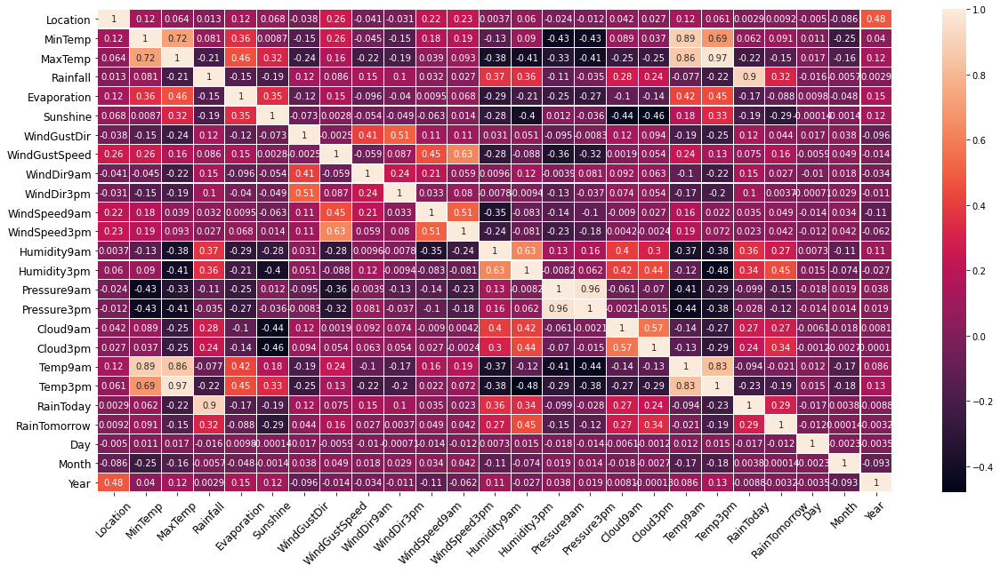

In [47]:
#Plotting heatmap to check the correlation
plt.figure(figsize=(20,10))
sns.heatmap(df_new.corr(),linewidths=.1,annot=True)
plt.yticks(rotation=0,fontsize=12);
plt.xticks(rotation=45,fontsize=12);

# Observations
- MaxTemp and MinTemp are higly correlated with Temp9am and Temp3pm 
- MaxTemp and MinTemp are higly correlated with each other.
- MaxTemp and MinTemp are higly negatively correlated with Pressure9am, Pressure3pm
- MaxTemp is also higly negatively correlated with Humidity9am, Humidity3pm
- WindDir3pm is highly negatively correlated with the Humidity9am
- WindSpeed3pm is highly negatively correlated with Temp9am and Temp3pm

This may lead to multicolinearity issue which needs to be addressed in the later part

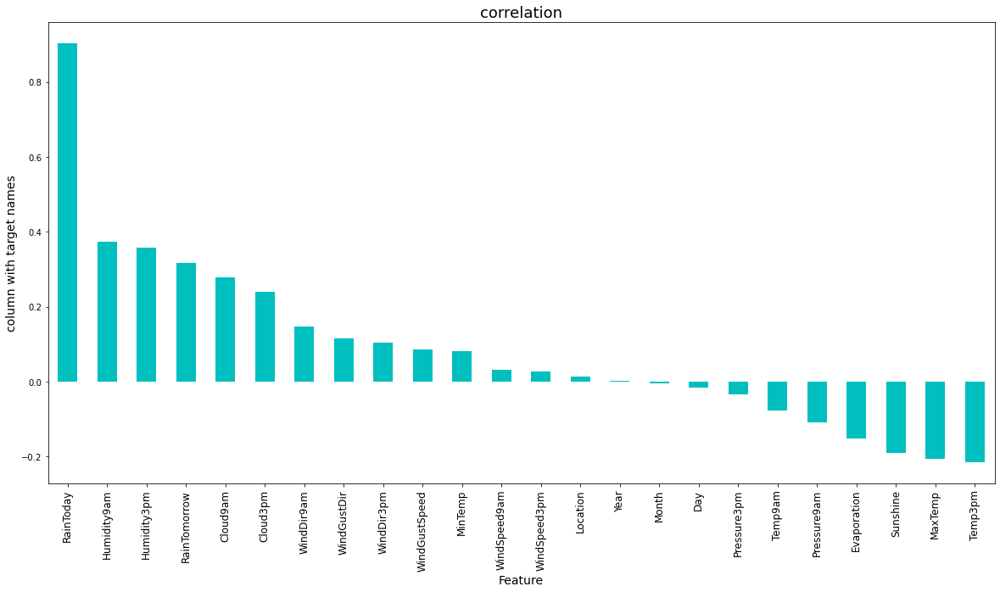

In [48]:
#Plotting bar plot to get better insights on target variable correlation with other columns .
plt.figure(figsize=(20,10))
df_new.corr()['Rainfall'].sort_values(ascending=False).drop(['Rainfall']).plot(kind='bar',color='c')
plt.xlabel('Feature',fontsize=14)
plt.ylabel('column with target names',fontsize=14)
plt.xticks(rotation=90,fontsize=12);
plt.title('correlation',fontsize=18)
plt.show()

# Observations

- The target 'Rainfall' is highly positively correlated with the feature 'RainToday'

- The target 'Rainfall' is positively well correlated with the following features
    - Humidity9am
    - Humidity3pm
    - RainTomorrow
    - Cloud9am
    - Cloud3pm

- The target 'Rainfall' is least positively correlated with the following features
    - WindDir9am
    - WindGustDir
    - WindDir3pm
    - WindGustspeed
    - MinTemp
    - WindSpeed9am
    - WindSpeed3pm
    - Location

- The features 'Year','Month' has least correlation with the target 'Rainfall', which says 'Year' and 'Month' has least impact on 'Rainfall'. Hence they can be dropped

- The target 'Rainfall' is most negatively correlated with the feature 'Temp3pm'

- The target 'Rainfall' is negatively correlated with the remaining features

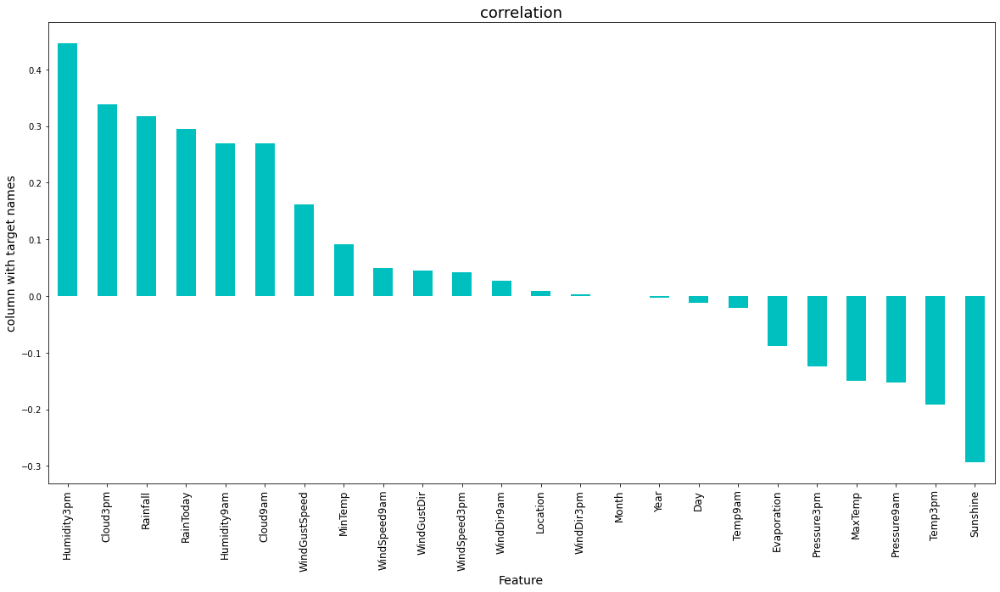

In [49]:
#Plotting bar plot to get better insights on target variable correlation with other columns .
plt.figure(figsize=(20,10))
df_new.corr()['RainTomorrow'].sort_values(ascending=False).drop(['RainTomorrow']).plot(kind='bar',color='c')
plt.xlabel('Feature',fontsize=14)
plt.ylabel('column with target names',fontsize=14)
plt.xticks(rotation=90,fontsize=12);
plt.title('correlation',fontsize=18)
plt.show()

# Observations
- The target 'RainTomorrow' is positively well correlated with the following features
    - Humidity3pm
    - Cloud3pm
    - Rainfall
    - RainToday
    - Humidity9am
    - Cloud9am

- The target 'RainTomorrow' is least positively correlated with the following features
    - WindGustspeed
    - MinTemp
    - WindSpeed9am
    - WindGustDir
    - WindSpeed3pm
    - WindDir9am
    - Location
    - WindDir3pm
    
- The feature 'Month' has least correlation with the target 'RainTomorrow', which says 'Month' has least impact on 'RainTomorrow'. Hence it can be dropped.

- The target 'RainTomorrow' is highly negatively correlated with the feature 'Sunshine
- The target 'RainTomorrow' is negatively correlated with the remaining features

# 1. Model training for target 'RainTomorrow'

In [50]:
#Dropping the least correlated column
df_new_rt = df_new.drop(["Month"],axis=1)

# Preprocessing

## Splitting feature and label into x and y

In [51]:
#Splitting the data for model training and Assigning variables for the further procedure
x = df_new_rt.drop("RainTomorrow", axis=1)
y = df_new_rt["RainTomorrow"]

# Scaling the data using Standard Scaler

In [52]:
#importing necessary libraries
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split

In [53]:
sc=StandardScaler()
X = pd.DataFrame(sc.fit_transform(x), columns=x.columns)

The data has been scaled using standard scaler.

# Using VIF(Variance Inflation Factor) to remove multicolinearity

In [54]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["vif_Features"]=[variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif["Features"]=X.columns
vif

,vif_Features,Features
0,1.587438,Location
1,8.438035,MinTemp
2,26.290205,MaxTemp
3,5.618620,Rainfall
4,1.503351,Evaporation
5,1.633337,Sunshine
6,1.621182,WindGustDir
7,2.151515,WindGustSpeed
8,1.397232,WindDir9am
9,1.492213,WindDir3pm


Since there can be seen high VIF for Total volume, the column shall be dropped and check for VIF again.

In [55]:
#Droping Temp3pm column
X = X.drop(["Temp3pm"],axis=1)

In [56]:
# Checking VIF again
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["vif_Features"]=[variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif["Features"]=X.columns
vif

,vif_Features,Features
0,1.585832,Location
1,8.369011,MinTemp
2,9.570455,MaxTemp
3,5.615950,Rainfall
4,1.501891,Evaporation
5,1.632425,Sunshine
6,1.618326,WindGustDir
7,2.142374,WindGustSpeed
8,1.396564,WindDir9am
9,1.491398,WindDir3pm


After dropping Temp3pm, Pressure9am can be seen having high VIF,hence dropping that column.

In [57]:
#Droping Pressure9am column
X = X.drop(["Pressure9am"],axis=1)

In [58]:
# Checking VIF again
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["vif_Features"]=[variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif["Features"]=X.columns
vif

,vif_Features,Features
0,1.585696,Location
1,8.208098,MinTemp
2,9.164874,MaxTemp
3,5.604371,Rainfall
4,1.490243,Evaporation
5,1.632071,Sunshine
6,1.603166,WindGustDir
7,2.123890,WindGustSpeed
8,1.372974,WindDir9am
9,1.424448,WindDir3pm


After dropping Pressure9am, Temp9am can be seen having high VIF,hence dropping that column.

In [59]:
#Droping Temp9am column
X = X.drop(["Temp9am"],axis=1)

In [60]:
# Checking VIF again
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["vif_Features"]=[variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif["Features"]=X.columns
vif

,vif_Features,Features
0,1.584545,Location
1,4.383821,MinTemp
2,5.347124,MaxTemp
3,5.594375,Rainfall
4,1.485171,Evaporation
5,1.627444,Sunshine
6,1.601383,WindGustDir
7,2.086115,WindGustSpeed
8,1.372677,WindDir9am
9,1.423918,WindDir3pm


After dropping Temp9am, Rainfall can be seen having high VIF. But the Rainfall is well positively correlated with target 'RainTomorrow'. So we shall not drop this column

The multicolinearity has been treated to some extent, But some features still have VIF values above 4. But dropping too many columns have a negative impact on the model. So letting them be for now and moving forward with next step.

# Oversampling

In [61]:
#Checking value counts in target 'y'
y.value_counts()

0    6165
1    1822
Name: RainTomorrow, dtype: int64

We can see that there is a significant difference in the classes hence lets fix this using SMOTE

In [62]:
#Importing necessary library to treat imbalance
from imblearn.over_sampling import SMOTE

# Treating imbalance
SM = SMOTE()
X, y = SM.fit_resample(X,y)

In [63]:
#Checking value counts in target 'y'
y.value_counts()

0    6165
1    6165
Name: RainTomorrow, dtype: int64

Now we can see that the imbalance issue has been fixed.

# Finding Best Random State and Accuracy:

In [64]:
#importing necessary libraries
import warnings
warnings.simplefilter("ignore")
warnings.filterwarnings("ignore")
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier as KNN
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier, BaggingClassifier
from xgboost import XGBClassifier as xgb
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score
from sklearn import metrics

In [65]:
maxAccu=0
maxRS=0
for i in range(1,200):
    X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=.30, random_state =i)
    rf = RandomForestClassifier()
    rf.fit(X_train, y_train)
    pred = rf.predict(X_test)
    acc=accuracy_score(y_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best accuracy is ",maxAccu," on Random_state ",maxRS)

Best accuracy is  0.9413354960800216  on Random_state  10


The above is the best accuracy score on that Random_state

# Important Features

In [66]:
# Lets ckeck the feature importance using Random Forest Classifier

rf = RandomForestClassifier()
rf.fit(X_train, y_train)
importances = pd.DataFrame({'Features':X.columns, 'Importance':np.round(rf.feature_importances_,3)})
importances = importances.sort_values('Importance', ascending=False).set_index('Features')
importances

,Importance
Features,
Humidity3pm,0.159
Cloud3pm,0.097
Humidity9am,0.062
Rainfall,0.058
WindGustSpeed,0.058
Sunshine,0.057
Cloud9am,0.056
Pressure3pm,0.048
MinTemp,0.043


# Creating train_test split

In [67]:
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=.30,random_state=maxRS)

## Decision Tree Classifier

In [68]:
DTC = DecisionTreeClassifier()
DTC.fit(X_train,y_train)
predDTC = DTC.predict(X_test)

print(accuracy_score(y_test, predDTC))
print(confusion_matrix(y_test, predDTC))
print(classification_report(y_test,predDTC))

0.870235198702352
[[1573  245]
 [ 235 1646]]
              precision    recall  f1-score   support

           0       0.87      0.87      0.87      1818
           1       0.87      0.88      0.87      1881

    accuracy                           0.87      3699
   macro avg       0.87      0.87      0.87      3699
weighted avg       0.87      0.87      0.87      3699



We observe that the DTC has accuracy 87.02 %

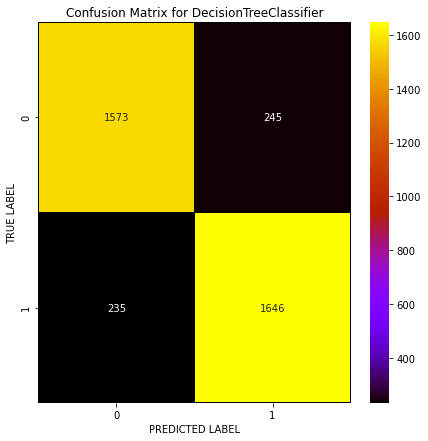

In [69]:
# Lets plot confusion matrix for DecisionTreeClassifier
cm = confusion_matrix(y_test,predDTC)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="gnuplot",xticklabels=x_axis_labels,yticklabels=y_axis_labels)

plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for DecisionTreeClassifier')
plt.show()

# Random Forest Classifier

In [70]:
rf = RandomForestClassifier()
rf.fit(X_train,y_train)

# Prediction
predrf = rf.predict(X_test)

print(accuracy_score(y_test, predrf))
print(confusion_matrix(y_test, predrf))
print(classification_report(y_test,predrf))

0.9389024060556908
[[1700  118]
 [ 108 1773]]
              precision    recall  f1-score   support

           0       0.94      0.94      0.94      1818
           1       0.94      0.94      0.94      1881

    accuracy                           0.94      3699
   macro avg       0.94      0.94      0.94      3699
weighted avg       0.94      0.94      0.94      3699



With this model we are getting an accuracy score of 93.89%

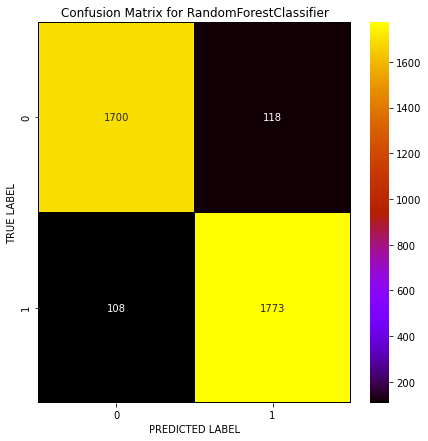

In [71]:
# Lets plot confusion matrix for RandomForestClassifier
cm = confusion_matrix(y_test,predrf)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="gnuplot",xticklabels=x_axis_labels,yticklabels=y_axis_labels)

plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for RandomForestClassifier')
plt.show()

# Logistic Regression

In [72]:
lr = LogisticRegression()
lr.fit(X_train,y_train)

# Prediction
predlr = lr.predict(X_test)

print(accuracy_score(y_test, predlr))
print(confusion_matrix(y_test, predlr))
print(classification_report(y_test,predlr))

0.7723709110570425
[[1434  384]
 [ 458 1423]]
              precision    recall  f1-score   support

           0       0.76      0.79      0.77      1818
           1       0.79      0.76      0.77      1881

    accuracy                           0.77      3699
   macro avg       0.77      0.77      0.77      3699
weighted avg       0.77      0.77      0.77      3699



With this model we are getting an accuracy score of 77%

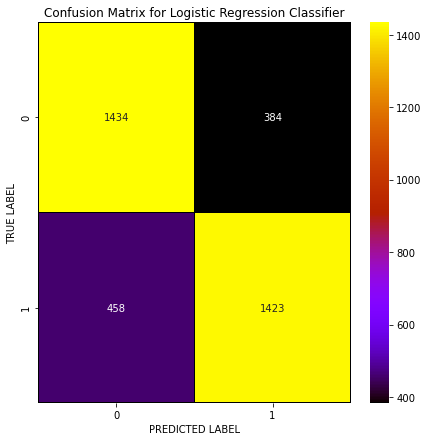

In [73]:
# Lets plot confusion matrix for Logistic Regression
cm = confusion_matrix(y_test,predlr)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="gnuplot",xticklabels=x_axis_labels,yticklabels=y_axis_labels)

plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for Logistic Regression Classifier')
plt.show()

# AdaBoost Classifier

In [74]:
# Checking accuracy for AdaBoost Classifier
abc = AdaBoostClassifier()
abc.fit(X_train,y_train)

# Prediction
predabc = abc.predict(X_test)

print(accuracy_score(y_test, predabc))
print(confusion_matrix(y_test, predabc))
print(classification_report(y_test,predabc))

0.8194106515274399
[[1496  322]
 [ 346 1535]]
              precision    recall  f1-score   support

           0       0.81      0.82      0.82      1818
           1       0.83      0.82      0.82      1881

    accuracy                           0.82      3699
   macro avg       0.82      0.82      0.82      3699
weighted avg       0.82      0.82      0.82      3699



With this model we are getting an accuracy score of 81.94%

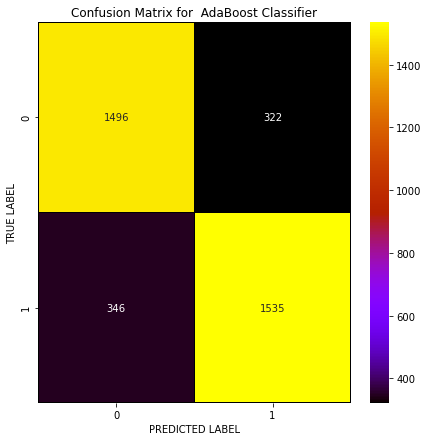

In [75]:
# Lets plot confusion matrix for  AdaBoost Classifier
cm = confusion_matrix(y_test,predabc)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="gnuplot",xticklabels=x_axis_labels,yticklabels=y_axis_labels)

plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for  AdaBoost Classifier')
plt.show()

# Gradient Boosting Classifier

In [76]:
gb = GradientBoostingClassifier()
gb.fit(X_train,y_train)

# Prediction
predgb = gb.predict(X_test)

print(accuracy_score(y_test, predgb))
print(confusion_matrix(y_test, predgb))
print(classification_report(y_test,predgb))

0.8561773452284401
[[1576  242]
 [ 290 1591]]
              precision    recall  f1-score   support

           0       0.84      0.87      0.86      1818
           1       0.87      0.85      0.86      1881

    accuracy                           0.86      3699
   macro avg       0.86      0.86      0.86      3699
weighted avg       0.86      0.86      0.86      3699



With this model we are getting an accuracy score of 85.6%

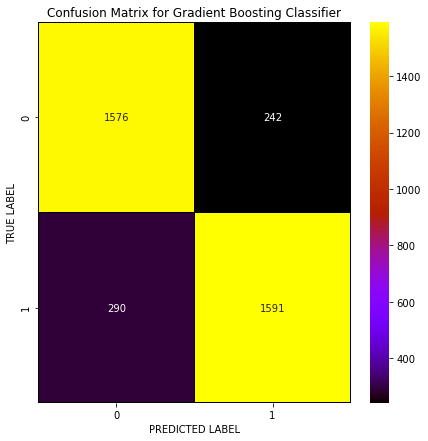

In [77]:
# Lets plot confusion matrix for Gradient Boosting Classifier
cm = confusion_matrix(y_test,predgb)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="gnuplot",xticklabels=x_axis_labels,yticklabels=y_axis_labels)

plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for Gradient Boosting Classifier')
plt.show()

# XGB Classifier

In [78]:
# Checking accuracy for XGBClassifier
xgb = xgb(verbosity=0)
xgb.fit(X_train,y_train)

# Prediction
predxgb = xgb.predict(X_test)

print(accuracy_score(y_test, predxgb))
print(confusion_matrix(y_test, predxgb))
print(classification_report(y_test,predxgb))

0.9313327926466612
[[1701  117]
 [ 137 1744]]
              precision    recall  f1-score   support

           0       0.93      0.94      0.93      1818
           1       0.94      0.93      0.93      1881

    accuracy                           0.93      3699
   macro avg       0.93      0.93      0.93      3699
weighted avg       0.93      0.93      0.93      3699



With this model we are getting an accuracy score of 93.1%

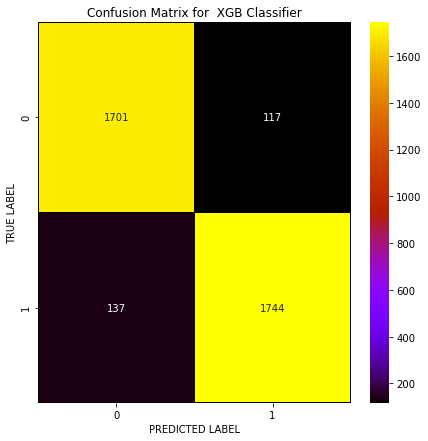

In [79]:
# Lets plot confusion matrix for  XGBClassifier
cm = confusion_matrix(y_test,predxgb)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="gnuplot",xticklabels=x_axis_labels,yticklabels=y_axis_labels)

plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for  XGB Classifier')
plt.show()

# Extra Trees Classifier

In [81]:
from sklearn.ensemble import ExtraTreesClassifier
# Checking accuracy for ExtraTreesClassifier
xtc = ExtraTreesClassifier()
xtc.fit(X_train,y_train)

# Prediction
predxtc = xtc.predict(X_test)

print(accuracy_score(y_test, predxtc))
print(confusion_matrix(y_test, predxtc))
print(classification_report(y_test,predxtc))

0.9521492295214923
[[1715  103]
 [  74 1807]]
              precision    recall  f1-score   support

           0       0.96      0.94      0.95      1818
           1       0.95      0.96      0.95      1881

    accuracy                           0.95      3699
   macro avg       0.95      0.95      0.95      3699
weighted avg       0.95      0.95      0.95      3699



With this model we are getting an accuracy score of 95.21%

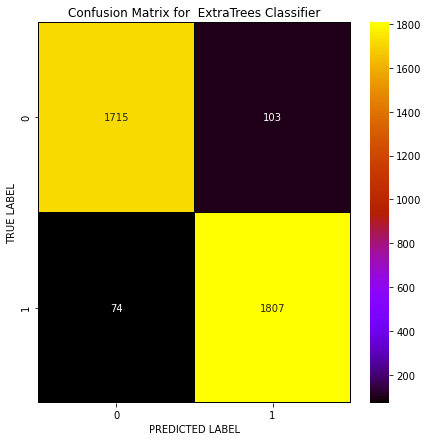

In [82]:
# Lets plot confusion matrix for  ExtraTreesClassifier
cm = confusion_matrix(y_test,predxtc)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="gnuplot",xticklabels=x_axis_labels,yticklabels=y_axis_labels)

plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for  ExtraTrees Classifier')
plt.show()

# KNeighborsClassifier

In [83]:
# Checking accuracy for KNeighborsClassifier
knn = KNN()
knn.fit(X_train,y_train)

# Prediction
predknn = knn.predict(X_test)

print(accuracy_score(y_test, predknn))
print(confusion_matrix(y_test, predknn))
print(classification_report(y_test,predknn))

0.8656393619897269
[[1407  411]
 [  86 1795]]
              precision    recall  f1-score   support

           0       0.94      0.77      0.85      1818
           1       0.81      0.95      0.88      1881

    accuracy                           0.87      3699
   macro avg       0.88      0.86      0.86      3699
weighted avg       0.88      0.87      0.86      3699



KNN has accuracy 86.56%

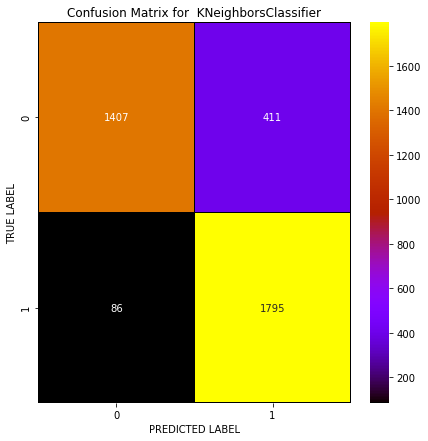

In [85]:
# Lets plot confusion matrix for  KNeighborsClassifier
cm = confusion_matrix(y_test,predknn)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="gnuplot",xticklabels=x_axis_labels,yticklabels=y_axis_labels)

plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for  KNeighborsClassifier')
plt.show()

# Support Vector Machine Classifier

In [86]:
# Checking accuracy for Support Vector Machine Classifier
svc = SVC()
svc.fit(X_train,y_train)

#Prediction
predsvc = svc.predict(X_test)

print(accuracy_score(y_test, predsvc))
print(confusion_matrix(y_test, predsvc))
print(classification_report(y_test,predsvc))

0.8564476885644768
[[1538  280]
 [ 251 1630]]
              precision    recall  f1-score   support

           0       0.86      0.85      0.85      1818
           1       0.85      0.87      0.86      1881

    accuracy                           0.86      3699
   macro avg       0.86      0.86      0.86      3699
weighted avg       0.86      0.86      0.86      3699



SVC has accuracy 85.64%.

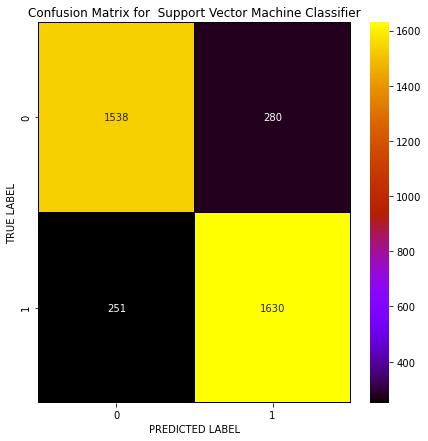

In [87]:
# Lets plot confusion matrix for  Support Vector Machine Classifier
cm = confusion_matrix(y_test,predsvc)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="gnuplot",xticklabels=x_axis_labels,yticklabels=y_axis_labels)

plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for  Support Vector Machine Classifier')
plt.show()

# Checking the Cross Validation Score

In [92]:
# cv score for Logistic Regression
print('Logistic Regression:',cross_val_score(lr,X,y,cv=5).mean())

# cv score for Decision Tree classifier
print('Decision Tree classifier:',cross_val_score(DTC,X,y,cv=5).mean())

# cv score for Random Forest Classifier
print('Random Forest Classifier:',cross_val_score(rf,X,y,cv=5).mean())

# cv score for AdaBoosting Classifier
print('AdaBoosting Classifier:',cross_val_score(abc,X,y,cv=5).mean())

# cv score for Gradient Boosting Classifier
print('Gradient Boosting Classifier:',cross_val_score(gb,X,y,cv=5).mean())

# cv score for XGB Classifier
print('XGB Classifier:',cross_val_score(xgb,X,y,cv=5).mean())

# cv score for Extra Trees Classifier
print('Extra Trees Classifier:',cross_val_score(xtc,X,y,cv=5).mean())

# cv score for KNeighborsClassifier
print('KNeighborsClassifier:',cross_val_score(knn,X,y,cv=5).mean())

# cv score for Support Vector Machine Classifier
print('Support Vector Machine Classifier:',cross_val_score(svc,X,y,cv=5).mean())


Logistic Regression: 0.7118410381184104
Decision Tree classifier: 0.7409570154095702
Random Forest Classifier: 0.7924574209245743
AdaBoosting Classifier: 0.6691808596918085
Gradient Boosting Classifier: 0.6611516626115166
XGB Classifier: 0.6987834549878345
Extra Trees Classifier: 0.8037307380373073
KNeighborsClassifier: 0.7334144363341444
Support Vector Machine Classifier: 0.7362530413625304


From the above we can observe the difference between the accuracy score and cross validation score is least in SVC and Gradient Boosting classifier but Extra trees classifier has higher accuracy than other classifiers. Hence we can predict that ETC is the best model.

# Hyper parameter tuning

In [93]:
from sklearn.model_selection import GridSearchCV

In [94]:
# ExtraTrees Classifier
parameters = {'criterion' : ['gini','entropy'],
              'random_state' : [10, 50, 1000],
              'max_depth' : [0, 10, 20],
              'n_jobs' : [-2, -1, 1],
              'n_estimators' : [50,100, 200, 300]}

In [95]:
GCV=GridSearchCV(ExtraTreesClassifier(),parameters,cv=5)

In [96]:
GCV.fit(X_train,y_train)

GridSearchCV(cv=5, estimator=ExtraTreesClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [0, 10, 20],
                         'n_estimators': [50, 100, 200, 300],
                         'n_jobs': [-2, -1, 1],
                         'random_state': [10, 50, 1000]})

In [97]:
GCV.best_params_

{'criterion': 'gini',
 'max_depth': 20,
 'n_estimators': 200,
 'n_jobs': -2,
 'random_state': 10}

In [98]:
Rainfall_Tomorrow=ExtraTreesClassifier(criterion='gini', max_depth=20, n_estimators=200, n_jobs=-2, random_state=10)
Rainfall_Tomorrow.fit(X_train, y_train)
pred = Rainfall_Tomorrow.predict(X_test)
acc=accuracy_score(y_test,pred)
print(acc*100)

94.566098945661


After Hyperparameter Tuning the accuracy score has increased to 94.56%

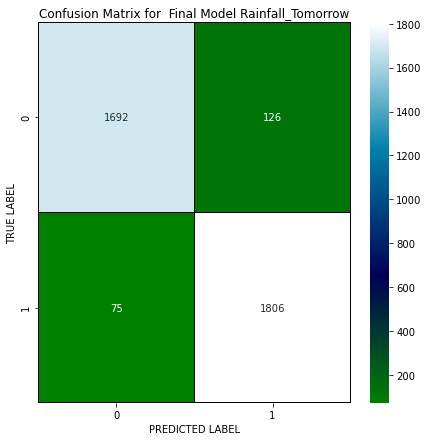

In [99]:
# Lets plot confusion matrix for  FinalModel Rainfall_Tomorrow
cm = confusion_matrix(y_test,pred)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="ocean",xticklabels=x_axis_labels,yticklabels=y_axis_labels)

plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for  Final Model Rainfall_Tomorrow')
plt.show() 

# Plotting ROC and Compare AUC for the best model

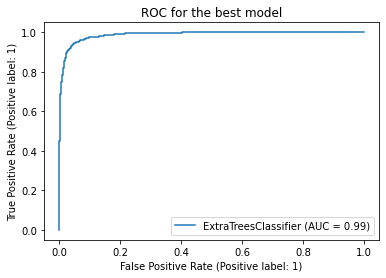

In [100]:
from sklearn.metrics import plot_roc_curve
plot_roc_curve(Rainfall_Tomorrow, X_test, y_test)
plt.title("ROC for the best model")
plt.show()

The predicted model has 99% AUC which is approximately ideal

# Saving the Model

In [101]:
import joblib
joblib.dump(Rainfall_Tomorrow,"Prediction_of_Rainfall_Tomorrow.pkl")

['Prediction_of_Rainfall_Tomorrow.pkl']

The model is now saved using joblib library.

# Predicting from the saved model

In [102]:
# Loading the saved model
model=joblib.load("Prediction_of_Rainfall_Tomorrow.pkl")

#Prediction
prediction = model.predict(X_test)
prediction

array([1, 1, 1, ..., 0, 0, 1])

In [103]:
pd.DataFrame([model.predict(X_test)[:],y_test[:]],index=["Predicted","Original"]).T

,Predicted,Original
0,1,1
1,1,1
2,1,1
3,1,1
4,0,0
5,0,0
6,1,0
7,0,1
8,1,1
9,0,0


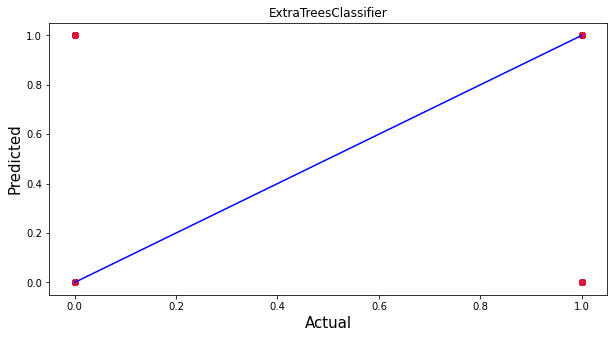

In [104]:
# Plotting Actual vs Predicted to get better insights
plt.figure(figsize=(10,5))
plt.scatter(y_test, prediction, c='crimson')
p1 = max(max(prediction), max(y_test))
p2 = min(min(prediction), min(y_test))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('Actual', fontsize=15)
plt.ylabel('Predicted', fontsize=15)
plt.title("ExtraTreesClassifier")
plt.show()

We can see that the Actual Values and Predicted Values look similar.

# 2. Model training for target 'Rainfall'

In [105]:
#Dropping the least correlated column
df_new_rf = df_new.drop(["Year","Month"],axis=1)

# Preprocessing

## Splitting feature and label into x and y

In [106]:
#Splitting the data for model training and Assigning variables for the further procedure
x = df_new_rf.drop("Rainfall", axis=1)
y = df_new_rf["Rainfall"]

# Scaling the data using Standard Scaler

In [107]:
#importing necessary libraries
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split

sc=StandardScaler()
X = pd.DataFrame(sc.fit_transform(x), columns=x.columns)

The data has been scaled using standard scaler.

# Using VIF(Variance Inflation Factor) to remove multicolinearity

In [108]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["vif_Features"]=[variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif["Features"]=X.columns
vif

,vif_Features,Features
0,1.186869,Location
1,8.313227,MinTemp
2,26.275159,MaxTemp
3,1.492193,Evaporation
4,1.647178,Sunshine
5,1.611628,WindGustDir
6,2.209566,WindGustSpeed
7,1.385009,WindDir9am
8,1.485567,WindDir3pm
9,1.794045,WindSpeed9am


Since there can be seen high VIF for Total volume, the column shall be dropped and check for VIF again.

In [109]:
#Droping Temp3pm column
X = X.drop(["Temp3pm"],axis=1)

In [110]:
# Checking VIF again
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["vif_Features"]=[variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif["Features"]=X.columns
vif

,vif_Features,Features
0,1.184574,Location
1,8.247014,MinTemp
2,9.582451,MaxTemp
3,1.490611,Evaporation
4,1.646275,Sunshine
5,1.608600,WindGustDir
6,2.200838,WindGustSpeed
7,1.384439,WindDir9am
8,1.484841,WindDir3pm
9,1.793674,WindSpeed9am


After dropping Temp3pm, Pressure9am can be seen having high VIF,hence dropping that column.

In [111]:
#Droping Pressure9am column
X = X.drop(["Pressure9am"],axis=1)

In [112]:
# Checking VIF again
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["vif_Features"]=[variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif["Features"]=X.columns
vif

,vif_Features,Features
0,1.184338,Location
1,8.080636,MinTemp
2,9.180464,MaxTemp
3,1.479472,Evaporation
4,1.645673,Sunshine
5,1.592077,WindGustDir
6,2.177684,WindGustSpeed
7,1.361817,WindDir9am
8,1.419870,WindDir3pm
9,1.785783,WindSpeed9am


After dropping Pressure9am, Temp9am can be seen having high VIF,hence dropping that column.

In [113]:
#Droping Temp9am column
X = X.drop(["Temp9am"],axis=1)

In [114]:
# Checking VIF again
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["vif_Features"]=[variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif["Features"]=X.columns
vif

,vif_Features,Features
0,1.171479,Location
1,4.383313,MinTemp
2,5.307619,MaxTemp
3,1.476112,Evaporation
4,1.640820,Sunshine
5,1.591264,WindGustDir
6,2.140971,WindGustSpeed
7,1.360822,WindDir9am
8,1.419722,WindDir3pm
9,1.771780,WindSpeed9am


After dropping Temp9am, Rainfall can be seen having high VIF. But the Rainfall is well positively correlated with target 'RainTomorrow'. So we shall not drop this column

The multicolinearity has been treated to some extent, But some features still have VIF values above 4. But dropping too many columns have a negative impact on the model. So letting them be for now and moving forward with next step.


# Finding Best Random State and Accuracy:

In [119]:
#importing necessary libraries
import warnings
warnings.simplefilter("ignore")
warnings.filterwarnings("ignore")
import joblib
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.linear_model import LinearRegression,Ridge, Lasso
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import SGDRegressor
from sklearn.metrics import classification_report
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import GradientBoostingRegressor
from xgboost import XGBRegressor
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import BaggingRegressor
from sklearn import metrics

In [121]:
maxAccu=0
maxRS=0
for i in range(1,200):
    X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=.30, random_state=i)
    mod = RandomForestRegressor()
    mod.fit(X_train, y_train)
    pred = mod.predict(X_test)
    acc=r2_score(y_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Maximum r2 score is ",maxAccu," on Random_state ",maxRS)

Maximum r2 score is  0.8865274639535751  on Random_state  195


We have got the best accuracy score at the best random state

# Important Features

In [122]:
# Lets ckeck the feature importance using Random Forest Regressor

rfr = RandomForestRegressor()
rfr.fit(X_train, y_train)
importances = pd.DataFrame({'Features':X.columns, 'Importance':np.round(rfr.feature_importances_,3)})
importances = importances.sort_values('Importance', ascending=False).set_index('Features')
importances

,Importance
Features,
RainToday,0.807
Humidity9am,0.021
MinTemp,0.019
Pressure3pm,0.015
Day,0.014
MaxTemp,0.013
Humidity3pm,0.013
WindSpeed9am,0.012
WindGustSpeed,0.012


With the help of Random Forest Regressor we are able to list down the importance or priority given to a feature as per it's involvement or weightage in predicting our label.

# Random Forest Regressor

In [126]:
# Checking R2 score for Random Forest Regressor
rf=RandomForestRegressor()
rf.fit(X_train,y_train)

# prediction
predrf=rf.predict(X_test)
print('R2_Score:',r2_score(y_test,predrf))

# Metric evaluation
print('MAE:',metrics.mean_absolute_error(y_test, predrf))
print('MSE:',metrics.mean_squared_error(y_test, predrf))
print("RMSE:",np.sqrt(metrics.mean_squared_error(y_test, predrf)))

R2_Score: 0.8753613714612437
MAE: 0.15829423923305902
MSE: 0.09750985056976842
RMSE: 0.31226567305704356


We have got an accuracy score of 87.53% with this model

# Decision Tree Regressor

In [127]:
# Checking R2 score for Decision Tree Regressor
dt=DecisionTreeRegressor()
dt.fit(X_train,y_train)

# prediction
preddt=dt.predict(X_test)
print('R2_Score:',r2_score(y_test,preddt))

# Metric evaluation
print('MAE:',metrics.mean_absolute_error(y_test, preddt))
print('MSE:',metrics.mean_squared_error(y_test, preddt))
print("RMSE:",np.sqrt(metrics.mean_squared_error(y_test, preddt)))

R2_Score: 0.7639064287809314
MAE: 0.17740681301562877
MSE: 0.1847055693724667
RMSE: 0.42977385840982313


We have got an accuracy score of 76.39% with this model

# GradientBoosting Regressor

In [128]:
# Checking R2 score for GradientBoosting Regressor
gb=GradientBoostingRegressor()
gb.fit(X_train,y_train)

# prediction
predgb=gb.predict(X_test)
print('R2_Score:',r2_score(y_test,predgb))

# Metric Evaluation
print('MAE:',metrics.mean_absolute_error(y_test, predgb))
print('MSE:',metrics.mean_squared_error(y_test, predgb))
print("RMSE:",np.sqrt(metrics.mean_squared_error(y_test, predgb)))

R2_Score: 0.8500224268650491
MAE: 0.18311508792856596
MSE: 0.1173335338863919
RMSE: 0.3425398281753406


We have got an accuracy score of 85% with this model

# BaggingRegressor

In [129]:
br=BaggingRegressor()
br.fit(X_train,y_train)

# prediction
predbr=br.predict(X_test)
print('R2_Score:',r2_score(y_test,predbr))

# Metric Evaluation
print('MAE:',metrics.mean_absolute_error(y_test, predbr))
print('MSE:',metrics.mean_squared_error(y_test, predbr))
print("RMSE:",np.sqrt(metrics.mean_squared_error(y_test, predbr)))

R2_Score: 0.8618101321531275
MAE: 0.16070829450675272
MSE: 0.10811153429704642
RMSE: 0.32880318474285863


We have got an accuracy score of 86% with this model

# ExtraTrees Regressor

In [130]:
# Checking R2 score for Extra Trees Regressor

et=ExtraTreesRegressor()
et.fit(X_train,y_train)

# prediction
predet=et.predict(X_test)
print('R2_Score:',r2_score(y_test,predet))

# Metric Evaluation
print('MAE:',metrics.mean_absolute_error(y_test, predet))
print('MSE:',metrics.mean_squared_error(y_test, predet))
print("RMSE:",np.sqrt(metrics.mean_squared_error(y_test, predet)))

R2_Score: 0.8798063889026921
MAE: 0.1381437778365413
MSE: 0.09403233327374917
RMSE: 0.30664691955692164


We have got an accuracy score of 88% with this model

# XGB Regressor

In [131]:
# Checking R2 score for XGB Regressor
from xgboost import XGBRegressor as xgb

xgb=xgb(verbosity=0)
xgb.fit(X_train,y_train)

# prediction
predxgb=xgb.predict(X_test)
print('R2_Score:',r2_score(y_test,predxgb))

# Metric Evaluation
print('MAE:',metrics.mean_absolute_error(y_test, predxgb))
print('MSE:',metrics.mean_squared_error(y_test, predxgb))
print("RMSE:",np.sqrt(metrics.mean_squared_error(y_test, predxgb)))

R2_Score: 0.8631352229901986
MAE: 0.16357447246401977
MSE: 0.1070748620307595
RMSE: 0.3272229546207899


We have got an accuracy score of 86% with this model

# Cross-Validation

In [132]:
# Checking cv score for Random Forest Regressor
print('Random Forest:',cross_val_score(rf,x,y,cv=5).mean())

# Checking cv score for Decision Tree Regressor
print('Decision Tree:',cross_val_score(dt,x,y,cv=5).mean())

# Checking cv score for Gradient Boosting Regressor
print('Gradient Boosting:',cross_val_score(gb,x,y,cv=5).mean())

# Checking cv score for Bagging Regressor
print('Bagging Regressor:',cross_val_score(br,x,y,cv=5).mean())

# Checking cv score for ExtraTreesRegressor
print('ExtraTreesRegressor:',cross_val_score(et,x,y,cv=5).mean())

# Checking cv score for XGBRegressor
print('XGBRegressor:',cross_val_score(xgb,x,y,cv=5).mean())

Random Forest: 0.8527981120632908
Decision Tree: 0.7287125532957052
Gradient Boosting: 0.8302161076300514
Bagging Regressor: 0.8443872994654067
ExtraTreesRegressor: 0.8625591396271665
XGBRegressor: 0.8370112418236797


From the above we can observe the difference between the accuracy score and cross validation score is least in Random forestregressor. Hence we can predict that Random forestregressor is the best model.

# Hyper parameter tuning

In [143]:
#Importing necessary libraries
from sklearn.model_selection import GridSearchCV

In [147]:
# Giving RFR parameters.
parameters = {'n_estimators' : [50,100,200],
              'criterion' :['mse', 'mae'],
              'max_depth' : [4, 6, 8]}

In [148]:
GCV=GridSearchCV(rf,parameters,cv=5)

In [149]:
# Tuning the model using GCV.
GCV.fit(X_train,y_train)

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid={'criterion': ['mse', 'mae'], 'max_depth': [4, 6, 8],
                         'n_estimators': [50, 100, 200]})

In [158]:
# Getting the best parameters for RFR.
GCV.best_params_

{'criterion': 'mse', 'max_depth': 8, 'n_estimators': 200}

In [151]:
Rainfall=RandomForestRegressor(criterion='mse',max_depth=8,n_estimators=200,)
Rainfall.fit(X_train, y_train)
pred = Rainfall.predict(X_test)
print('R2_Score:',r2_score(y_test,pred)*100)
print("RMSE value:",np.sqrt(metrics.mean_squared_error(y_test, pred)))
print('MAE:',metrics.mean_absolute_error(y_test, pred))
print('MSE:',metrics.mean_squared_error(y_test, pred))

R2_Score: 85.88147767743621
RMSE value: 0.332347592451413
MAE: 0.17698276850709005
MSE: 0.11045492220825051


After Hyperparameter Tuning the accuracy score is 85.88 %

# Saving the Model

In [153]:
import joblib
joblib.dump(Rainfall,"Prediction_of_Rainfall.pkl")

['Prediction_of_Rainfall.pkl']

The model is now saved using joblib library.

# Predicting from the saved model

In [154]:
# Loading the saved model
model=joblib.load("Prediction_of_Rainfall.pkl")

In [155]:
#Prediction
prediction = model.predict(X_test)
prediction

array([0.02526946, 0.02135759, 2.28919542, ..., 0.04496693, 0.0307711 ,
       0.03075498])

In [156]:
pd.DataFrame([model.predict(X_test)[:],y_test[:]],index=["Predicted","Original"]).T

,Predicted,Original
0,0.025269,0.000000
1,0.021358,0.000000
2,2.289195,2.721295
3,0.040323,0.000000
4,0.020629,0.000000
5,0.039355,0.000000
6,0.046579,0.000000
7,0.006912,0.000000
8,0.009836,0.000000
9,0.079405,0.182322


We can see that the Actual Values and Predicted Values look similar.